In [ ]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 21.8 MB 6.1 MB/s 
     |████████████████████████████████| 11.1 MB 10.4 MB/s 
     |████████████████████████████████| 596 kB 20.4 MB/s 
     |████████████████████████████████| 102 kB 67.5 MB/s 
     |████████████████████████████████| 690 kB 14.8 MB/s 
     |████████████████████████████████| 4.7 MB 61.2 MB/s 
     |████████████████████████████████| 63 kB 1.2 MB/s 
     |████████████████████████████████| 812 kB 54.5 MB/s 
     |████████████████████████████████| 38.1 MB 1.1 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.2.0-py2.py3-none-any.whl size=262599 sha256=ee8718d521650ae66e1a0883b8c983576a8a30ee8992d7ba9cd37a48dae08ccd
  Stored in directory: /tmp/pip-ephem-wheel-cache-b0xzd_kw/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=2709

In [ ]:
import os 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn')
import numpy as np
from sklearn import preprocessing

import missingno as msno

import warnings
warnings.filterwarnings('ignore')

import re
from pandas_profiling import ProfileReport

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
dir_path = "/content/drive/MyDrive/Colab Notebooks/Datathone"


df_title_result = pd.DataFrame()
df_credits_result = pd.DataFrame()

title_dataframe = {}

for i in os.listdir(dir_path):
  for a in os.listdir(os.path.join(dir_path,i)):
    
    try:
      if a == 'titles.csv':
        print(os.path.join(dir_path,i,a))
        
        df_title = pd.read_csv(os.path.join(dir_path,i,a))

        title_dataframe[i] = df_title
        


        df_title["Platform"] = i
        df_title_result = pd.concat([df_title, df_title_result], ignore_index=True)

      else:
        df_credits = pd.read_csv(os.path.join(dir_path,i,a))
        df_credits["Platform"] = i
        df_credits_result = pd.concat([df_credits, df_credits_result], ignore_index=True)
    except:
      pass

/content/drive/MyDrive/Colab Notebooks/Datathone/Netflix/titles.csv
/content/drive/MyDrive/Colab Notebooks/Datathone/Amazon/titles.csv
/content/drive/MyDrive/Colab Notebooks/Datathone/Paramount/titles.csv
/content/drive/MyDrive/Colab Notebooks/Datathone/Disney plus/titles.csv


In [ ]:
df_title_result

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
0,tm74391,Fantasia,MOVIE,Walt Disney's timeless masterpiece is an extra...,1940,G,120,"['animation', 'family', 'music', 'fantasy']",['US'],NaN,tt0032455,7.7,94681.0,57.751,7.4,Disney plus
1,tm67803,Snow White and the Seven Dwarfs,MOVIE,"A beautiful girl, Snow White, takes refuge in ...",1937,G,83,"['fantasy', 'family', 'romance', 'animation', ...",['US'],NaN,tt0029583,7.6,195321.0,107.137,7.1,Disney plus
2,tm82546,Pinocchio,MOVIE,Lonely toymaker Geppetto has his wishes answer...,1940,G,88,"['animation', 'comedy', 'family', 'fantasy']",['US'],NaN,tt0032910,7.5,141937.0,71.160,7.1,Disney plus
3,tm79357,Bambi,MOVIE,Bambi's tale unfolds from season to season as ...,1942,G,70,"['animation', 'drama', 'family']",['US'],NaN,tt0034492,7.3,140406.0,68.136,7.0,Disney plus
4,tm62671,Treasure Island,MOVIE,Enchanted by the idea of locating treasure bur...,1950,PG,96,"['family', 'action']","['GB', 'US']",NaN,tt0043067,6.9,8229.0,10.698,6.5,Disney plus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20032,tm1014599,Fine Wine,MOVIE,A beautiful love story that can happen between...,2021,NaN,100,"['romance', 'drama']",['NG'],NaN,tt13857480,6.9,39.0,0.966,NaN,Netflix
20033,tm1108171,Edis Starlight,MOVIE,Rising star Edis's career journey with ups and...,2021,NaN,74,"['music', 'documentation']",[],NaN,NaN,NaN,NaN,1.036,8.5,Netflix
20034,tm1045018,Clash,MOVIE,A man from Nigeria returns to his family in Ca...,2021,NaN,88,"['family', 'drama']","['NG', 'CA']",NaN,tt14620732,6.5,32.0,0.709,NaN,Netflix
20035,tm1098060,Shadow Parties,MOVIE,A family faces destruction in a long-running c...,2021,NaN,116,"['action', 'thriller']",[],NaN,tt10168094,6.2,9.0,2.186,NaN,Netflix


# \----------------------------------------

# 전체 결측치 확인

In [ ]:
df_credits_result.isnull().sum()

person_id        0
id               0
name             0
character    30670
role             0
Platform         0
dtype: int64

In [ ]:
df_title_result.isnull().sum()

id                          0
title                       1
type                        0
description               156
release_year                0
age_certification       10945
runtime                     0
genres                      0
production_countries        0
seasons                 15592
imdb_id                  1672
imdb_score               2183
imdb_votes               2212
tmdb_popularity           709
tmdb_score               2997
Platform                    0
dtype: int64

# title 데이터 확인

In [ ]:
df_title_result.isnull().sum()

id                          0
title                       1
type                        0
description               156
release_year                0
age_certification       10945
runtime                     0
genres                      0
production_countries        0
seasons                 15592
imdb_id                  1672
imdb_score               2183
imdb_votes               2212
tmdb_popularity           709
tmdb_score               2997
Platform                    0
dtype: int64

In [ ]:
df_title_result[df_title_result['title'].isnull()]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
16036,tm1063792,NaN,MOVIE,NaN,2015,NaN,11,[],[],NaN,tt4661188,NaN,NaN,NaN,NaN,Netflix


## description 열 결측치 제거

In [ ]:
df_title_result[df_title_result['description'].isnull()]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
772,tm1104541,The Phantom Cat,MOVIE,NaN,2011,NaN,45,['documentation'],[],NaN,NaN,NaN,NaN,0.600,NaN,Disney plus
1124,ts286381,Tangled: Short Cuts,SHOW,NaN,2017,NaN,2,"['animation', 'comedy', 'family', 'fantasy']",['US'],1.0,tt12695540,7.4,14.0,NaN,NaN,Disney plus
1127,ts109332,Howie Mandel's Animals Doing Things,SHOW,NaN,2018,TV-14,30,['comedy'],['US'],2.0,tt8598154,3.6,64.0,NaN,NaN,Disney plus
1270,ts214449,Muppet Babies: Play Date,SHOW,NaN,2019,NaN,3,['family'],[],1.0,tt10349366,6.5,8.0,NaN,NaN,Disney plus
1357,tm1052946,My Music Story: Sukimaswitch,MOVIE,NaN,2020,NaN,81,"['documentation', 'music']",[],NaN,tt14287032,NaN,NaN,NaN,NaN,Disney plus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18936,tm840152,Amsterdam to Anatolia,MOVIE,NaN,2019,NaN,6,['thriller'],"['NL', 'PS', 'US', 'LB']",NaN,NaN,NaN,NaN,0.731,6.0,Netflix
18949,tm855232,Luccas Neto in: The End of Christmas,MOVIE,NaN,2019,NaN,71,[],[],NaN,NaN,NaN,NaN,1.380,7.8,Netflix
18983,tm896976,True: Rainbow Rescue,MOVIE,NaN,2020,NaN,23,['animation'],['US'],NaN,NaN,NaN,NaN,3.517,10.0,Netflix
19037,tm902993,Mama Drama,MOVIE,NaN,2020,NaN,85,['drama'],['US'],NaN,tt12424356,6.3,8.0,NaN,NaN,Netflix


In [ ]:
df_title_result['description'].replace(np.nan, 'No description', inplace=True)

In [ ]:
df_title_result[df_title_result['description'].isnull()]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform


## age 열 결측치 제거

In [ ]:
df_title_result.isnull().sum()

id                          0
title                       1
type                        0
description                 0
release_year                0
age_certification       10945
runtime                     0
genres                      0
production_countries        0
seasons                 15592
imdb_id                  1672
imdb_score               2183
imdb_votes               2212
tmdb_popularity           709
tmdb_score               2997
Platform                    0
dtype: int64

In [ ]:
df_title_result.sample(20)

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
18442,tm912415,Urzila Carlson: Overqualified Loser,MOVIE,Stand-up comedian Urzila Carlson keeps the cro...,2020,NaN,62,['comedy'],[],NaN,tt12572032,6.3,366.0,3.251,4.9,Netflix
12459,tm984433,Lost Heart,MOVIE,"Hannah, a burnt out, mega-music star, returns ...",2020,NaN,98,"['thriller', 'drama']",[],NaN,NaN,NaN,NaN,0.918,NaN,Amazon
9530,tm146627,Jenny McCarthy's Dirty Sexy Funny,MOVIE,"With the help of a hilarious, all-female slate...",2014,NaN,60,['comedy'],['US'],NaN,tt4712994,5.5,90.0,2.304,3.9,Amazon
1504,tm1034867,Let's Be Tigers,MOVIE,Avalon’s not ready to process the loss of her ...,2021,PG,15,['drama'],['US'],NaN,NaN,NaN,NaN,9.390,6.9,Disney plus
12488,ts225837,The Wolf,SHOW,"Towards the end of the Tang Dynasty, Zhu Wen u...",2020,NaN,44,"['drama', 'action']",['CN'],1.0,NaN,NaN,NaN,8.023,8.1,Amazon
12509,ts223869,Under the Power,SHOW,In the final years of the reign of Jiajing Emp...,2019,NaN,45,"['drama', 'history', 'romance', 'action']",['CN'],1.0,tt11482096,7.7,203.0,13.355,8.0,Amazon
12957,tm461807,Romang,MOVIE,75-year-old Cho Nam-bong and 71-year-old Lee M...,2019,NaN,112,"['romance', 'drama']",['KR'],NaN,tt10449460,6.8,175.0,1.588,8.5,Amazon
9459,tm137772,Farmland,MOVIE,Most Americans have never stepped foot on a fa...,2014,NaN,77,['documentation'],['US'],NaN,tt3631430,6.2,171.0,0.850,NaN,Amazon
5203,tm64601,Mule Train,MOVIE,A prospector discovers natural cement and sugg...,1950,NaN,69,"['western', 'music', 'action']",['US'],NaN,tt0042761,6.6,101.0,1.400,6.0,Amazon
3383,ts35862,The Jim Gaffigan Show,SHOW,Comedy about a husband and wife trying to rais...,2015,TV-PG,21,['comedy'],['US'],2.0,tt3484406,7.5,2581.0,5.855,6.6,Paramount


In [ ]:
set(df_title_result['age_certification'])

{'G',
 'NC-17',
 'PG',
 'PG-13',
 'R',
 'TV-14',
 'TV-G',
 'TV-MA',
 'TV-PG',
 'TV-Y',
 'TV-Y7',
 nan}

In [ ]:
df_title_result['age_certification'].replace(np.nan, 'No age certification', inplace=True)

In [ ]:
for platform in title_dataframe.keys():
  title_dataframe[platform]['age_certification'].replace(np.nan, 'No age certification', inplace=True)

In [ ]:
set(df_title_result['age_certification'])

{'G',
 'NC-17',
 'No age certification',
 'PG',
 'PG-13',
 'R',
 'TV-14',
 'TV-G',
 'TV-MA',
 'TV-PG',
 'TV-Y',
 'TV-Y7'}

## Season 열 결측치 제거

In [ ]:
df_title_result.groupby('seasons').count()

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
seasons,,,,,,,,,,,,,,,
1.0,2325,2325,2325,2325,2325,2325,2325,2325,2325,2063,1933,1932,2181,1789,2325
2.0,786,786,786,786,786,786,786,786,786,759,743,743,750,684,786
3.0,467,467,467,467,467,467,467,467,467,456,451,450,457,417,467
4.0,280,280,280,280,280,280,280,280,280,276,271,271,274,252,280
5.0,169,169,169,169,169,169,169,169,169,169,169,169,169,158,169
6.0,121,121,121,121,121,121,121,121,121,120,120,120,119,114,121
7.0,73,73,73,73,73,73,73,73,73,72,72,72,73,70,73
8.0,44,44,44,44,44,44,44,44,44,42,41,41,43,43,44
9.0,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30


In [ ]:
df_title_result.loc[df_title_result['title']=='60 Minutes']

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
2112,ts10264,60 Minutes,SHOW,America's popular television News magazine in ...,1968,TV-PG,47,['documentation'],['US'],45.0,tt0123338,7.4,3768.0,20.022,7.0,Paramount


In [ ]:
df_title_result.loc[(df_title_result['type']=='SHOW') & (df_title_result['seasons'].isnull())]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform


- 티비쇼는 시즌에 대한 결측치가 존재하지 않았다.

In [ ]:
df_title_result.loc[(df_title_result['type']=='MOVIE') & (df_title_result['seasons'].isnull())]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
0,tm74391,Fantasia,MOVIE,Walt Disney's timeless masterpiece is an extra...,1940,G,120,"['animation', 'family', 'music', 'fantasy']",['US'],NaN,tt0032455,7.7,94681.0,57.751,7.4,Disney plus
1,tm67803,Snow White and the Seven Dwarfs,MOVIE,"A beautiful girl, Snow White, takes refuge in ...",1937,G,83,"['fantasy', 'family', 'romance', 'animation', ...",['US'],NaN,tt0029583,7.6,195321.0,107.137,7.1,Disney plus
2,tm82546,Pinocchio,MOVIE,Lonely toymaker Geppetto has his wishes answer...,1940,G,88,"['animation', 'comedy', 'family', 'fantasy']",['US'],NaN,tt0032910,7.5,141937.0,71.160,7.1,Disney plus
3,tm79357,Bambi,MOVIE,Bambi's tale unfolds from season to season as ...,1942,G,70,"['animation', 'drama', 'family']",['US'],NaN,tt0034492,7.3,140406.0,68.136,7.0,Disney plus
4,tm62671,Treasure Island,MOVIE,Enchanted by the idea of locating treasure bur...,1950,PG,96,"['family', 'action']","['GB', 'US']",NaN,tt0043067,6.9,8229.0,10.698,6.5,Disney plus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20031,tm1040816,Momshies! Your Soul is Mine,MOVIE,Three women with totally different lives accid...,2021,No age certification,108,['comedy'],['PH'],NaN,tt14412240,5.8,26.0,4.112,NaN,Netflix
20032,tm1014599,Fine Wine,MOVIE,A beautiful love story that can happen between...,2021,No age certification,100,"['romance', 'drama']",['NG'],NaN,tt13857480,6.9,39.0,0.966,NaN,Netflix
20033,tm1108171,Edis Starlight,MOVIE,Rising star Edis's career journey with ups and...,2021,No age certification,74,"['music', 'documentation']",[],NaN,NaN,NaN,NaN,1.036,8.5,Netflix
20034,tm1045018,Clash,MOVIE,A man from Nigeria returns to his family in Ca...,2021,No age certification,88,"['family', 'drama']","['NG', 'CA']",NaN,tt14620732,6.5,32.0,0.709,NaN,Netflix


- 영화들은 시즌 값이 전체가 null이었다. 
- 0으로 결측치 처리를 해도 무방하다.

In [ ]:
df_title_result['seasons'].replace(np.nan, 0, inplace=True)

In [ ]:
for platform in title_dataframe.keys(): 
  title_dataframe[platform]['seasons'].replace(np.nan, 0, inplace=True)

## imdb_id 열 결측치 제거

In [ ]:
df_title_result.isnull().sum()

id                         0
title                      1
type                       0
description                0
release_year               0
age_certification          0
runtime                    0
genres                     0
production_countries       0
seasons                    0
imdb_id                 1672
imdb_score              2183
imdb_votes              2212
tmdb_popularity          709
tmdb_score              2997
Platform                   0
dtype: int64

In [ ]:
df_title_result.groupby('id').count()

,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
id,,,,,,,,,,,,,,,
tm1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
tm100001,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
tm1000022,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
tm1000037,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
tm100013,1,1,1,1,1,1,1,1,1,0,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ts99532,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1
ts99533,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1
ts99534,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1


In [ ]:
df_title_result['imdb_id'].replace(np.nan, 'No id', inplace=True)

In [ ]:
for platform in title_dataframe.keys(): 
  title_dataframe[platform]['imdb_id'].replace(np.nan, 'No id', inplace=True)

## 평점 결측치 처리


In [ ]:
df_title_result[df_title_result['imdb_score'].isnull()]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
11,tm3616,Steamboat Willie,MOVIE,"Mickey Mouse, piloting a steamboat, delights h...",1928,G,8,['animation'],['US'],0.0,No id,NaN,NaN,10.513,7.4,Disney plus
13,tm71205,How to Play Baseball,MOVIE,Goofy shows us the national pastime. After a b...,1942,No age certification,8,"['comedy', 'animation']",['US'],0.0,No id,NaN,NaN,4.179,6.6,Disney plus
15,tm8579,Ferdinand the Bull,MOVIE,This Oscar-winning short tells of a bull who p...,1938,G,8,['comedy'],['US'],0.0,No id,NaN,NaN,10.983,6.5,Disney plus
16,tm134279,Three Little Pigs,MOVIE,The two pigs building houses of hay and sticks...,1933,No age certification,8,['comedy'],['US'],0.0,No id,NaN,NaN,8.883,6.8,Disney plus
17,tm74410,Tugboat Mickey,MOVIE,Mickey is performing routine maintenance on hi...,1940,No age certification,7,"['animation', 'family', 'comedy']",['US'],0.0,No id,NaN,NaN,5.845,6.2,Disney plus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20014,tm1035612,Dad Stop Embarrassing Me - The Afterparty,MOVIE,"Jamie Foxx, David Alan Grier and more from the...",2021,PG-13,37,[],['US'],0.0,No id,NaN,NaN,1.060,10.0,Netflix
20024,ts296698,Glimpses of a Future,SHOW,A few weeks into the first COVID-19 lockdown i...,2021,TV-PG,4,[],[],1.0,tt14754320,NaN,NaN,0.600,NaN,Netflix
20025,ts297061,Masameer County,SHOW,"A humorous view of a changing Saudi Arabia, as...",2021,TV-MA,23,[],['SA'],1.0,No id,NaN,NaN,0.959,8.0,Netflix
20030,ts307884,HQ Barbers,SHOW,When a family run barber shop in the heart of ...,2021,TV-14,24,['comedy'],['NG'],1.0,No id,NaN,NaN,0.600,NaN,Netflix


In [ ]:
df_title_result.loc[(df_title_result['imdb_score'].isnull()) & (df_title_result['imdb_votes'].isnull())]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
11,tm3616,Steamboat Willie,MOVIE,"Mickey Mouse, piloting a steamboat, delights h...",1928,G,8,['animation'],['US'],0.0,No id,NaN,NaN,10.513,7.4,Disney plus
13,tm71205,How to Play Baseball,MOVIE,Goofy shows us the national pastime. After a b...,1942,No age certification,8,"['comedy', 'animation']",['US'],0.0,No id,NaN,NaN,4.179,6.6,Disney plus
15,tm8579,Ferdinand the Bull,MOVIE,This Oscar-winning short tells of a bull who p...,1938,G,8,['comedy'],['US'],0.0,No id,NaN,NaN,10.983,6.5,Disney plus
16,tm134279,Three Little Pigs,MOVIE,The two pigs building houses of hay and sticks...,1933,No age certification,8,['comedy'],['US'],0.0,No id,NaN,NaN,8.883,6.8,Disney plus
17,tm74410,Tugboat Mickey,MOVIE,Mickey is performing routine maintenance on hi...,1940,No age certification,7,"['animation', 'family', 'comedy']",['US'],0.0,No id,NaN,NaN,5.845,6.2,Disney plus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20014,tm1035612,Dad Stop Embarrassing Me - The Afterparty,MOVIE,"Jamie Foxx, David Alan Grier and more from the...",2021,PG-13,37,[],['US'],0.0,No id,NaN,NaN,1.060,10.0,Netflix
20024,ts296698,Glimpses of a Future,SHOW,A few weeks into the first COVID-19 lockdown i...,2021,TV-PG,4,[],[],1.0,tt14754320,NaN,NaN,0.600,NaN,Netflix
20025,ts297061,Masameer County,SHOW,"A humorous view of a changing Saudi Arabia, as...",2021,TV-MA,23,[],['SA'],1.0,No id,NaN,NaN,0.959,8.0,Netflix
20030,ts307884,HQ Barbers,SHOW,When a family run barber shop in the heart of ...,2021,TV-14,24,['comedy'],['NG'],1.0,No id,NaN,NaN,0.600,NaN,Netflix


- score가 없으면 votes값도 없다.

In [ ]:
df_title_result.loc[(df_title_result['imdb_score'].isnull()) & -(df_title_result['tmdb_popularity'].isnull())]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
11,tm3616,Steamboat Willie,MOVIE,"Mickey Mouse, piloting a steamboat, delights h...",1928,G,8,['animation'],['US'],0.0,No id,NaN,NaN,10.513,7.4,Disney plus
13,tm71205,How to Play Baseball,MOVIE,Goofy shows us the national pastime. After a b...,1942,No age certification,8,"['comedy', 'animation']",['US'],0.0,No id,NaN,NaN,4.179,6.6,Disney plus
15,tm8579,Ferdinand the Bull,MOVIE,This Oscar-winning short tells of a bull who p...,1938,G,8,['comedy'],['US'],0.0,No id,NaN,NaN,10.983,6.5,Disney plus
16,tm134279,Three Little Pigs,MOVIE,The two pigs building houses of hay and sticks...,1933,No age certification,8,['comedy'],['US'],0.0,No id,NaN,NaN,8.883,6.8,Disney plus
17,tm74410,Tugboat Mickey,MOVIE,Mickey is performing routine maintenance on hi...,1940,No age certification,7,"['animation', 'family', 'comedy']",['US'],0.0,No id,NaN,NaN,5.845,6.2,Disney plus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20014,tm1035612,Dad Stop Embarrassing Me - The Afterparty,MOVIE,"Jamie Foxx, David Alan Grier and more from the...",2021,PG-13,37,[],['US'],0.0,No id,NaN,NaN,1.060,10.0,Netflix
20024,ts296698,Glimpses of a Future,SHOW,A few weeks into the first COVID-19 lockdown i...,2021,TV-PG,4,[],[],1.0,tt14754320,NaN,NaN,0.600,NaN,Netflix
20025,ts297061,Masameer County,SHOW,"A humorous view of a changing Saudi Arabia, as...",2021,TV-MA,23,[],['SA'],1.0,No id,NaN,NaN,0.959,8.0,Netflix
20030,ts307884,HQ Barbers,SHOW,When a family run barber shop in the heart of ...,2021,TV-14,24,['comedy'],['NG'],1.0,No id,NaN,NaN,0.600,NaN,Netflix


Q. 혹시 점수 null값이고 파퓰러리티가 널값이 아닌 애들은 영화가 마이너해서 점수가 없나?

-> 산포도를 확인하기 위해 tmdb_popularity 변수에 저장

In [ ]:
tmdb_popularity = df_title_result.loc[(df_title_result['imdb_score'].isnull()) & -(df_title_result['tmdb_popularity'].isnull())]
tmdb_popularity['tmdb_popularity']

11       10.513
13        4.179
15       10.983
16        8.883
17        5.845
          ...  
20014     1.060
20024     0.600
20025     0.959
20030     0.600
20033     1.036
Name: tmdb_popularity, Length: 1929, dtype: float64

In [ ]:
df_title_result.loc[df_title_result['tmdb_popularity'].isnull()]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
810,ts176104,Special Agent Oso: Three Healthy Steps,SHOW,Special Agent Oso: Three Healthy Steps is a sh...,2011,No age certification,2,['animation'],['US'],1.0,tt1842951,6.7,15.0,NaN,NaN,Disney plus
819,ts301931,Cosmos: A Spacetime Odyssey,SHOW,An exploration of our discovery of the laws of...,2014,TV-PG,43,['documentation'],"['FR', 'PT']",1.0,tt2395695,9.3,119455.0,NaN,NaN,Disney plus
967,tm479849,Egypt's Treasure Guardians,MOVIE,This fascinating programme follows a select ca...,2016,No age certification,44,['history'],['GB'],0.0,tt7264462,6.3,59.0,NaN,NaN,Disney plus
1124,ts286381,Tangled: Short Cuts,SHOW,No description,2017,No age certification,2,"['animation', 'comedy', 'family', 'fantasy']",['US'],1.0,tt12695540,7.4,14.0,NaN,NaN,Disney plus
1127,ts109332,Howie Mandel's Animals Doing Things,SHOW,No description,2018,TV-14,30,['comedy'],['US'],2.0,tt8598154,3.6,64.0,NaN,NaN,Disney plus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19909,tm1055586,Lethal Love,MOVIE,When a handsome man manipulates a mother and d...,2021,No age certification,87,['thriller'],[],0.0,tt14403532,4.4,215.0,NaN,NaN,Netflix
19946,tm1011248,30 March,MOVIE,"Ali, the fugitive from a murder he does not ev...",2021,No age certification,99,"['drama', 'thriller', 'crime']",[],0.0,tt13694540,4.4,96.0,NaN,NaN,Netflix
20003,tm1099342,Devdas Brothers,MOVIE,"After their first heartbreaks, four jilted you...",2021,No age certification,99,['drama'],[],0.0,tt12478372,3.2,50.0,NaN,NaN,Netflix
20005,tm898842,C/O Kaadhal,MOVIE,A heart warming film that explores the concept...,2021,No age certification,134,['drama'],[],0.0,tt11803618,7.8,339.0,NaN,NaN,Netflix


In [ ]:
df_title_result.loc[(df_title_result['tmdb_popularity'].isnull()) & (df_title_result['tmdb_score'].isnull())]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
810,ts176104,Special Agent Oso: Three Healthy Steps,SHOW,Special Agent Oso: Three Healthy Steps is a sh...,2011,No age certification,2,['animation'],['US'],1.0,tt1842951,6.7,15.0,NaN,NaN,Disney plus
819,ts301931,Cosmos: A Spacetime Odyssey,SHOW,An exploration of our discovery of the laws of...,2014,TV-PG,43,['documentation'],"['FR', 'PT']",1.0,tt2395695,9.3,119455.0,NaN,NaN,Disney plus
967,tm479849,Egypt's Treasure Guardians,MOVIE,This fascinating programme follows a select ca...,2016,No age certification,44,['history'],['GB'],0.0,tt7264462,6.3,59.0,NaN,NaN,Disney plus
1124,ts286381,Tangled: Short Cuts,SHOW,No description,2017,No age certification,2,"['animation', 'comedy', 'family', 'fantasy']",['US'],1.0,tt12695540,7.4,14.0,NaN,NaN,Disney plus
1127,ts109332,Howie Mandel's Animals Doing Things,SHOW,No description,2018,TV-14,30,['comedy'],['US'],2.0,tt8598154,3.6,64.0,NaN,NaN,Disney plus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19909,tm1055586,Lethal Love,MOVIE,When a handsome man manipulates a mother and d...,2021,No age certification,87,['thriller'],[],0.0,tt14403532,4.4,215.0,NaN,NaN,Netflix
19946,tm1011248,30 March,MOVIE,"Ali, the fugitive from a murder he does not ev...",2021,No age certification,99,"['drama', 'thriller', 'crime']",[],0.0,tt13694540,4.4,96.0,NaN,NaN,Netflix
20003,tm1099342,Devdas Brothers,MOVIE,"After their first heartbreaks, four jilted you...",2021,No age certification,99,['drama'],[],0.0,tt12478372,3.2,50.0,NaN,NaN,Netflix
20005,tm898842,C/O Kaadhal,MOVIE,A heart warming film that explores the concept...,2021,No age certification,134,['drama'],[],0.0,tt11803618,7.8,339.0,NaN,NaN,Netflix


tmdb_pop가 널값이고 tmdb_score도 널값인 애들이 708개

In [ ]:
df_title_result.loc[(df_title_result['tmdb_popularity'].isnull()) & (df_title_result['tmdb_score'].isnull()) & (df_title_result['imdb_score'].isnull())]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
1357,tm1052946,My Music Story: Sukimaswitch,MOVIE,No description,2020,No age certification,81,"['documentation', 'music']",[],0.0,tt14287032,NaN,NaN,NaN,NaN,Disney plus
1470,ts320286,Meet Spidey and His Amazing Friends - shorts,SHOW,No description,2021,No age certification,5,[],['US'],1.0,No id,NaN,NaN,NaN,NaN,Disney plus
3014,ts291963,Frankie and Frank,SHOW,No description,2008,TV-Y,1,['family'],[],1.0,tt14392744,NaN,NaN,NaN,NaN,Paramount
3019,ts163934,Zoo Vets,SHOW,Think a root canal is tough? Try performing on...,2009,No age certification,54,['reality'],['US'],1.0,tt2709190,NaN,NaN,NaN,NaN,Paramount
3031,tm640565,Hover Racers: Flying on Air,MOVIE,No description,2007,No age certification,46,['documentation'],['US'],0.0,tt1702368,NaN,NaN,NaN,NaN,Paramount
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16036,tm1063792,NaN,MOVIE,No description,2015,No age certification,11,[],[],0.0,tt4661188,NaN,NaN,NaN,NaN,Netflix
17250,ts106612,Chicken Soup for the Soul's Being Dad,SHOW,No description,2018,TV-PG,40,['reality'],[],1.0,tt8908110,NaN,NaN,NaN,NaN,Netflix
18231,ts314647,Patton Oswalt: I Love Everything,SHOW,Turning 50. Finding love again. Buying a house...,2020,No age certification,53,[],[],1.0,No id,NaN,NaN,NaN,NaN,Netflix
19500,tm1074621,Bridgerton - The Afterparty,MOVIE,"""Bridgerton"" cast members share behind-the-sce...",2021,No age certification,38,[],['US'],0.0,No id,NaN,NaN,NaN,NaN,Netflix


tmdb score, tmdb pop, imdb score 셋다 널값 = 474개

In [ ]:
# sns.scatterplot(data=df_title_result, x='id', y='tmdb_popularity', alpha=0.5)
# plt.figure(figsize=(15,15))
# plt.tight_layout()
# plt.show()

위 코드로 확인해보니까 이상치가 조금 있더라 그래서...

In [ ]:
df_title_result.loc[df_title_result['tmdb_popularity'] > 3000]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
1364,ts219003,Moon Knight,SHOW,"When Steven Grant, a mild-mannered gift-shop e...",2022,TV-14,48,"['action', 'scifi', 'drama', 'fantasy', 'horro...",['US'],1.0,tt10234724,7.5,128362.0,9323.832,8.5,Disney plus
4246,ts43075,Halo,SHOW,Depicting an epic 26th-century conflict betwee...,2022,TV-14,52,"['scifi', 'thriller', 'war', 'action']",['US'],1.0,tt2934286,7.1,31375.0,4579.160,8.7,Paramount


그래서 이상치들을 뽑아보니 가장 최근 데이터들이다. 아마 이목이 쏠려서 그런듯하다.

In [ ]:
# df_plot = df_title_result.drop(df_title_result['tmdb_popularity'] > 3000)
df_plot = df_title_result.drop(index = [1364,4246,9452])


비교를 위해 이상치 제거함.

In [ ]:
# fig, ax = plt.subplots(2,1, figsize=(10,10))
# axes = ax.flatten()
# sns.scatterplot(data=tmdb_popularity, x='id', y='tmdb_popularity', alpha=0.5, ax=axes[0])
# axes[0].get_xaxis().set_visible(False)

# sns.scatterplot(data=df_plot, x='id', y='tmdb_popularity', alpha=0.5, ax=axes[1])
# axes[1].get_xaxis().set_visible(False)

# plt.tight_layout()

# plt.show()

In [ ]:
# fig, ax = plt.subplots(figsize=(10,10))

# sns.scatterplot(data=tmdb_popularity, x='id', y='tmdb_popularity', alpha=0.2, ax=ax)
# sns.scatterplot(data=df_plot, x='id', y='tmdb_popularity', alpha=0.2, ax=ax)
# ax.get_xaxis().set_visible(False)


# plt.tight_layout()

# plt.show()

그래서 이상치 제거하고 두 산포를 비교해보니 차이가 조금 있긴 한데 데이터 분석에 사용할만큼 유의미하게 큰 의미는 없었다. 그래서 이 방식 말고 다른걸 써보기로 생각함.

In [ ]:
df_score = df_title_result[['imdb_id', 'imdb_score', 'imdb_votes', 'tmdb_popularity',
       'tmdb_score']]

In [ ]:
df_score

,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score
0,tt0032455,7.7,94681.0,57.751,7.4
1,tt0029583,7.6,195321.0,107.137,7.1
2,tt0032910,7.5,141937.0,71.160,7.1
3,tt0034492,7.3,140406.0,68.136,7.0
4,tt0043067,6.9,8229.0,10.698,6.5
...,...,...,...,...,...
20032,tt13857480,6.9,39.0,0.966,NaN
20033,No id,NaN,NaN,1.036,8.5
20034,tt14620732,6.5,32.0,0.709,NaN
20035,tt10168094,6.2,9.0,2.186,NaN


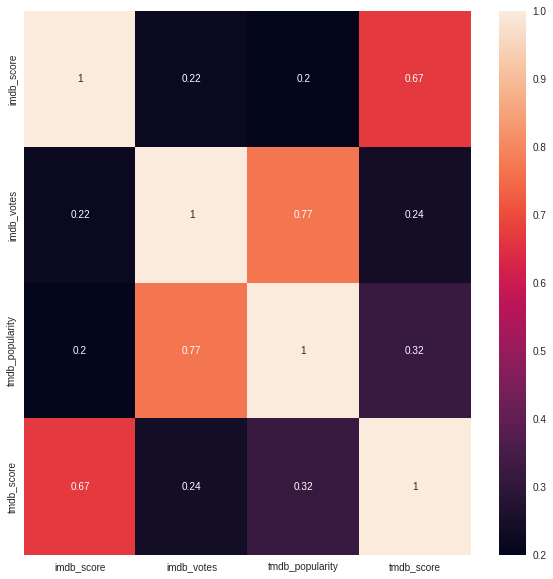

In [ ]:
sprm = df_score.corr(method='spearman').round(2)

# 시각화
plt.figure(figsize=(10,10))
sns.heatmap(sprm, annot=True)

그래서 쭉 뽑아다 상관계수를 보니 score 끼리 관계가 있고, pop + vote랑 관계가 있음.

그래서 1) 널값을 유추해서 집어넣거나 2) 그냥 드롭해버리는 방법이 있었는데

상관계수가 1이 아니기 때문에 유추해서 집어넣을 경우 데이터에 오차가 생길 수 있고

전체의 1% 규모의 데이터이긴 하지만 샘플 추출시에 그 1%에서만 뽑히지 않는다는 보장이 없기 때문에

그냥 드롭해버리기로 결정하였음.

### tmdb_popularity & tmdb_score & imdb_score & imdb_vote

In [ ]:
drop_index = df_title_result.loc[(df_title_result['tmdb_popularity'].isnull()) | (df_title_result['tmdb_score'].isnull()) | (df_title_result['imdb_score'].isnull()) | (df_title_result['imdb_votes'].isnull())].index
df_title_result.drop(drop_index, inplace=True)

In [ ]:
df_title_result.isnull().sum()

id                      0
title                   0
type                    0
description             0
release_year            0
age_certification       0
runtime                 0
genres                  0
production_countries    0
seasons                 0
imdb_id                 0
imdb_score              0
imdb_votes              0
tmdb_popularity         0
tmdb_score              0
Platform                0
dtype: int64

In [ ]:
df_title_result.to_csv("final_title.csv", mode='w')

In [ ]:
for platform in title_dataframe.keys(): 
    drop_index = title_dataframe[platform].loc[(title_dataframe[platform]['tmdb_popularity'].isnull()) | (title_dataframe[platform]['tmdb_score'].isnull()) | (title_dataframe[platform]['imdb_score'].isnull()) | (title_dataframe[platform]['imdb_votes'].isnull())].index
    title_dataframe[platform].drop(drop_index, inplace=True)

# Credit 데이터 확인

In [ ]:
df_credits_result.isnull().sum()

person_id        0
id               0
name             0
character    30670
role             0
Platform         0
dtype: int64

In [ ]:
df_credits_result[df_credits_result['character'].isnull()]

,person_id,id,name,character,role,Platform
4,23441,tm74391,Paul Satterfield,NaN,DIRECTOR,Disney plus
5,23442,tm74391,Hamilton Luske,NaN,DIRECTOR,Disney plus
6,23443,tm74391,Jim Handley,NaN,DIRECTOR,Disney plus
7,6164,tm74391,Ford Beebe,NaN,DIRECTOR,Disney plus
8,23444,tm74391,T. Hee,NaN,DIRECTOR,Disney plus
...,...,...,...,...,...,...
267681,1975318,tm1045018,Derel Isaac,NaN,ACTOR,Netflix
267683,1975627,tm1045018,Chealse Howell,NaN,ACTOR,Netflix
267686,363804,tm1045018,Pascal Atuma,NaN,DIRECTOR,Netflix
267692,530811,tm1098060,Toyin Aimakhu-Johnson,NaN,ACTOR,Netflix


In [ ]:
df_credits_result.sample(200)

,person_id,id,name,character,role,Platform
116865,29264,tm142888,Ron White,Judge Wilson,ACTOR,Amazon
67315,138204,tm159958,Mary Bovard,Autograph Seeker (uncredited),ACTOR,Amazon
161449,15220,tm361044,Elizabeth Sung,NaN,ACTOR,Amazon
133300,54531,tm160866,Kevin Covais,Allen Schwartz,ACTOR,Amazon
156568,1850586,tm422202,Christian Vilina,Wes,ACTOR,Amazon
...,...,...,...,...,...,...
148559,314611,tm142277,Nicolas Sarkozy,Self (archive footage) (uncredited),ACTOR,Amazon
112147,25455,tm191600,Judith Light,Diana Donahue,ACTOR,Amazon
197633,2316953,tm28905,Sarah Figoten,Young Gam Gam,ACTOR,Netflix
22700,49886,tm244126,Maurizio Terrazzano,Dinner Party Guest,ACTOR,Disney plus


In [ ]:
df_credits_result[df_credits_result['role']=='DIRECTOR']

,person_id,id,name,character,role,Platform
4,23441,tm74391,Paul Satterfield,NaN,DIRECTOR,Disney plus
5,23442,tm74391,Hamilton Luske,NaN,DIRECTOR,Disney plus
6,23443,tm74391,Jim Handley,NaN,DIRECTOR,Disney plus
7,6164,tm74391,Ford Beebe,NaN,DIRECTOR,Disney plus
8,23444,tm74391,T. Hee,NaN,DIRECTOR,Disney plus
...,...,...,...,...,...,...
267661,1790433,tm1040816,Easy Ferrer,NaN,DIRECTOR,Netflix
267673,1962840,tm1014599,Seyi Babatope,NaN,DIRECTOR,Netflix
267675,1278319,tm1108171,Kürşad Bayhan,NaN,DIRECTOR,Netflix
267686,363804,tm1045018,Pascal Atuma,NaN,DIRECTOR,Netflix


In [ ]:
df_credits_result[(df_credits_result['role']=='DIRECTOR') & (df_credits_result['character'].isnull())]

,person_id,id,name,character,role,Platform
4,23441,tm74391,Paul Satterfield,NaN,DIRECTOR,Disney plus
5,23442,tm74391,Hamilton Luske,NaN,DIRECTOR,Disney plus
6,23443,tm74391,Jim Handley,NaN,DIRECTOR,Disney plus
7,6164,tm74391,Ford Beebe,NaN,DIRECTOR,Disney plus
8,23444,tm74391,T. Hee,NaN,DIRECTOR,Disney plus
...,...,...,...,...,...,...
267661,1790433,tm1040816,Easy Ferrer,NaN,DIRECTOR,Netflix
267673,1962840,tm1014599,Seyi Babatope,NaN,DIRECTOR,Netflix
267675,1278319,tm1108171,Kürşad Bayhan,NaN,DIRECTOR,Netflix
267686,363804,tm1045018,Pascal Atuma,NaN,DIRECTOR,Netflix


In [ ]:
direc_index = df_credits_result[(df_credits_result['role']=='DIRECTOR')].index
print(direc_index)

Int64Index([     4,      5,      6,      7,      8,      9,     10,     11,
                12,     13,
            ...
            267612, 267623, 267624, 267640, 267647, 267661, 267673, 267675,
            267686, 267701],
           dtype='int64', length=16442)


In [ ]:
df_credits_result.loc[direc_index]['character']

4         NaN
5         NaN
6         NaN
7         NaN
8         NaN
         ... 
267661    NaN
267673    NaN
267675    NaN
267686    NaN
267701    NaN
Name: character, Length: 16442, dtype: object

In [ ]:
df_credits_result.loc[direc_index].replace({'character' : {np.nan: 'DIRECTOR'}})

,person_id,id,name,character,role,Platform
4,23441,tm74391,Paul Satterfield,DIRECTOR,DIRECTOR,Disney plus
5,23442,tm74391,Hamilton Luske,DIRECTOR,DIRECTOR,Disney plus
6,23443,tm74391,Jim Handley,DIRECTOR,DIRECTOR,Disney plus
7,6164,tm74391,Ford Beebe,DIRECTOR,DIRECTOR,Disney plus
8,23444,tm74391,T. Hee,DIRECTOR,DIRECTOR,Disney plus
...,...,...,...,...,...,...
267661,1790433,tm1040816,Easy Ferrer,DIRECTOR,DIRECTOR,Netflix
267673,1962840,tm1014599,Seyi Babatope,DIRECTOR,DIRECTOR,Netflix
267675,1278319,tm1108171,Kürşad Bayhan,DIRECTOR,DIRECTOR,Netflix
267686,363804,tm1045018,Pascal Atuma,DIRECTOR,DIRECTOR,Netflix


In [ ]:
df_credits_result.loc[direc_index] = df_credits_result.loc[direc_index].replace({'character' : {np.nan: 'DIRECTOR'}})

In [ ]:
df_credits_result[(df_credits_result['role']=='DIRECTOR') & (df_credits_result['character'].isnull())]

,person_id,id,name,character,role,Platform


In [ ]:
df_credits_result

,person_id,id,name,character,role,Platform
0,23433,tm74391,Deems Taylor,Narrator - Narrative Introductions,ACTOR,Disney plus
1,5910,tm74391,Walt Disney,Mickey Mouse (segment 'The Sorcerer's Apprenti...,ACTOR,Disney plus
2,23436,tm74391,Julietta Novis,Soloist (segment 'Ave Maria') (singing voice),ACTOR,Disney plus
3,23434,tm74391,Leopold Stokowski,Himself - Conductor of The Philadelphia Orchestra,ACTOR,Disney plus
4,23441,tm74391,Paul Satterfield,DIRECTOR,DIRECTOR,Disney plus
...,...,...,...,...,...,...
267697,1347054,tm1098060,Nnenna Rachael Okonkwo,Afinni,ACTOR,Netflix
267698,157590,tm1098060,Lucien Morgan,Dr. Ian Stones,ACTOR,Netflix
267699,129059,tm1098060,Magdalena Korpas,Jane,ACTOR,Netflix
267700,2050199,tm1098060,Mistura Olusanya,Nurse Titi,ACTOR,Netflix


In [ ]:
df_credits_result.isnull().sum()

person_id        0
id               0
name             0
character    14228
role             0
Platform         0
dtype: int64

In [ ]:
df_credits_result[(df_credits_result['role']=='ACTOR') & (df_credits_result['character'].isnull())]

,person_id,id,name,character,role,Platform
418,6139,tm91651,Pinto Colvig,NaN,ACTOR,Disney plus
858,113885,ts30718,Jack Sheldon,NaN,ACTOR,Disney plus
859,113886,ts30718,Bob Dorough,NaN,ACTOR,Disney plus
860,113887,ts30718,Lynn Ahrens,NaN,ACTOR,Disney plus
861,113889,ts30718,Blossom Dearie,NaN,ACTOR,Disney plus
...,...,...,...,...,...,...
267660,1894297,tm1040816,Francis Mata,NaN,ACTOR,Netflix
267667,678884,tm1014599,Segun Arinze,NaN,ACTOR,Netflix
267681,1975318,tm1045018,Derel Isaac,NaN,ACTOR,Netflix
267683,1975627,tm1045018,Chealse Howell,NaN,ACTOR,Netflix


In [ ]:
movie_list = list(set(df_credits_result['id']))

In [ ]:
df_credits_result.groupby('name').count().sort_values('person_id', ascending=False)

,person_id,id,character,role,Platform
name,,,,,
Frank Welker,95,95,88,95,95
George 'Gabby' Hayes,79,79,79,79,79
Jim Cummings,72,72,69,72,72
Roy Rogers,71,71,71,71,71
Bess Flowers,68,68,68,68,68
...,...,...,...,...,...
Jane Lapotaire,1,1,1,1,1
Jane Lambert,1,1,1,1,1
Jane Jones,1,1,1,1,1


In [ ]:
actor_index = df_credits_result[(df_credits_result['role']=='ACTOR')&(df_credits_result['character'].isnull())].index
print(actor_index)

Int64Index([   418,    858,    859,    860,    861,    862,    863,   1467,
              1996,   1997,
            ...
            267655, 267656, 267657, 267658, 267659, 267660, 267667, 267681,
            267683, 267692],
           dtype='int64', length=14228)


In [ ]:
df_credits_result.loc[actor_index]['character']

418       NaN
858       NaN
859       NaN
860       NaN
861       NaN
         ... 
267660    NaN
267667    NaN
267681    NaN
267683    NaN
267692    NaN
Name: character, Length: 14228, dtype: object

In [ ]:
df_credits_result.loc[actor_index].replace({'character' : {np.nan: 'others'}})

,person_id,id,name,character,role,Platform
418,6139,tm91651,Pinto Colvig,others,ACTOR,Disney plus
858,113885,ts30718,Jack Sheldon,others,ACTOR,Disney plus
859,113886,ts30718,Bob Dorough,others,ACTOR,Disney plus
860,113887,ts30718,Lynn Ahrens,others,ACTOR,Disney plus
861,113889,ts30718,Blossom Dearie,others,ACTOR,Disney plus
...,...,...,...,...,...,...
267660,1894297,tm1040816,Francis Mata,others,ACTOR,Netflix
267667,678884,tm1014599,Segun Arinze,others,ACTOR,Netflix
267681,1975318,tm1045018,Derel Isaac,others,ACTOR,Netflix
267683,1975627,tm1045018,Chealse Howell,others,ACTOR,Netflix


In [ ]:
df_credits_result.loc[actor_index] = df_credits_result.loc[actor_index].replace({'character' : {np.nan: 'others'}})

In [ ]:
df_credits_result.isnull().sum()

person_id    0
id           0
name         0
character    0
role         0
Platform     0
dtype: int64

In [ ]:
df_credits_result.to_csv("final_credit.csv", mode='w')

# \----------------------------------------

# 데이터 분석

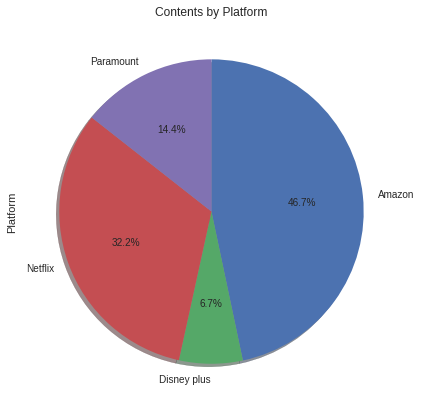

In [ ]:
# 플랫폼별 콘텐츠 개수
platform_contents = df_title_result.groupby(['Platform'])['Platform'].count()

count_content = platform_contents.plot.pie(figsize=(7, 7), autopct='%.1f%%', startangle=90, 
                               counterclock=False,  shadow=True, table=False)

count_content.set_title('Contents by Platform')

plt.show()

전반적으로 불균형한 데이터 구조를 가지고 있다.

## 전체 기본 정보 분석

In [ ]:
df_title_result

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
0,tm74391,Fantasia,MOVIE,Walt Disney's timeless masterpiece is an extra...,1940,G,120,"['animation', 'family', 'music', 'fantasy']",['US'],0.0,tt0032455,7.7,94681.0,57.751,7.4,Disney plus
1,tm67803,Snow White and the Seven Dwarfs,MOVIE,"A beautiful girl, Snow White, takes refuge in ...",1937,G,83,"['fantasy', 'family', 'romance', 'animation', ...",['US'],0.0,tt0029583,7.6,195321.0,107.137,7.1,Disney plus
2,tm82546,Pinocchio,MOVIE,Lonely toymaker Geppetto has his wishes answer...,1940,G,88,"['animation', 'comedy', 'family', 'fantasy']",['US'],0.0,tt0032910,7.5,141937.0,71.160,7.1,Disney plus
3,tm79357,Bambi,MOVIE,Bambi's tale unfolds from season to season as ...,1942,G,70,"['animation', 'drama', 'family']",['US'],0.0,tt0034492,7.3,140406.0,68.136,7.0,Disney plus
4,tm62671,Treasure Island,MOVIE,Enchanted by the idea of locating treasure bur...,1950,PG,96,"['family', 'action']","['GB', 'US']",0.0,tt0043067,6.9,8229.0,10.698,6.5,Disney plus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20023,tm1097142,My Bride,MOVIE,The story follows a young man and woman who go...,2021,No age certification,93,"['comedy', 'drama', 'romance']",['EG'],0.0,tt14216488,4.9,281.0,2.923,5.3,Netflix
20026,tm878575,The Heartbreak Club,MOVIE,"Coping with heartbreak, the shy owner of floun...",2021,No age certification,101,"['comedy', 'drama', 'romance']",['ID'],0.0,tt11841144,6.2,188.0,2.227,8.0,Netflix
20027,ts286386,The Big Day,SHOW,"For six engaged couples, happily ever after be...",2021,TV-MA,45,"['reality', 'romance']",['US'],2.0,tt13887518,4.6,327.0,1.400,6.0,Netflix
20029,tm1004011,Time to Dance,MOVIE,When a ballroom dancer’s shot at a crucial tou...,2021,No age certification,107,"['drama', 'romance']",['IN'],0.0,tt8622232,2.2,950.0,2.911,4.0,Netflix


In [ ]:
df_title_result = df_title_result.reset_index(drop=True)

In [ ]:
df_title_result = df_title_result.astype({'release_year':'int'})

### 년도별 분석

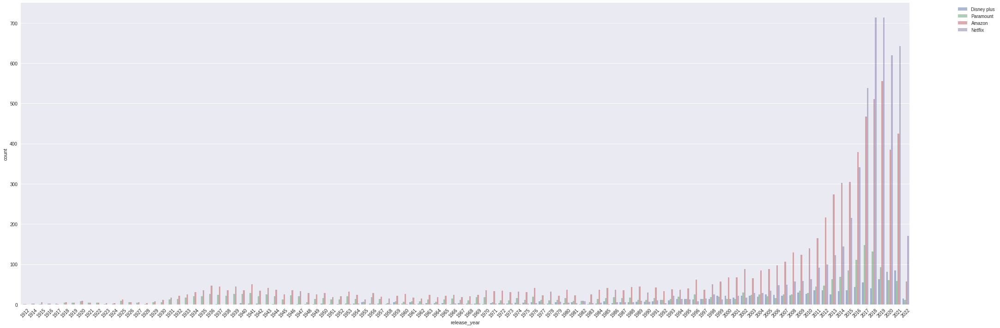

In [ ]:
fig, ax = plt.subplots(figsize=(30,10))
sns.countplot(data=df_title_result, x='release_year', hue='Platform', ax=ax, alpha=0.5)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 45)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.tight_layout()
plt.show()

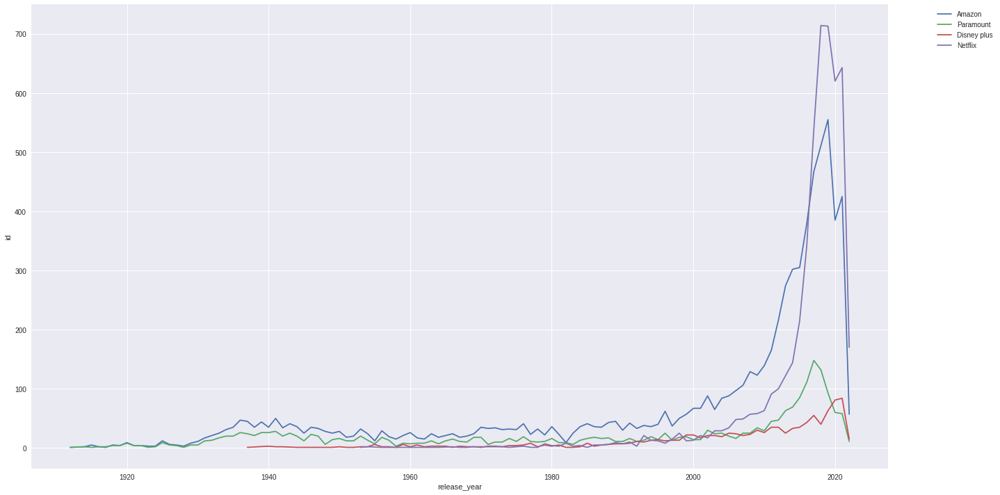

In [ ]:
countplot = df_title_result.groupby(['release_year','Platform'], as_index=False).count()

fig, ax = plt.subplots(figsize=(20,10))
sns.lineplot(data=countplot, x='release_year', y='id',hue='Platform', ax=ax)

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.tight_layout()
plt.show()

In [ ]:
# 2017년 이후 콘텐츠 수
after_2017 = df_title_result.loc[(df_title_result['release_year'] > 2017)]
before_2017 = df_title_result.loc[((df_title_result['release_year'] <= 2017) & (df_title_result['release_year'] > 2000))]
before_millenium = before_2017 = df_title_result.loc[(df_title_result['release_year'] <= 2000)]

print(len(after_2017), len(before_2017), len(before_millenium))

print('--- it\'s after 2017 ---')
# 넷플릭스
netflix_count = len(after_2017.loc[(after_2017['Platform'] == 'Netflix')])
print('Netflix: ', netflix_count)

# 아마존
amz_count = len(after_2017.loc[(after_2017['Platform'] == 'Amazon')])
print('Amazon: ',amz_count)

# 파라마운트
paramount_count = len(after_2017.loc[(after_2017['Platform'] == 'Paramount')])
print('Paramount: ',paramount_count)

# 디즈니플러스
disney_count = len(after_2017.loc[(after_2017['Platform'] == 'Disney plus')])
print('Disney plus: ',disney_count)

# 2000~2017
print('--- it\'s between 2000~2017 ---')
# 넷플릭스
netflix_count2 = len(before_2017.loc[(before_2017['Platform'] == 'Netflix')])
print('Netflix: ', netflix_count2)

# 아마존
amz_count2 = len(before_2017.loc[(before_2017['Platform'] == 'Amazon')])
print('Amazon: ',amz_count2)

# 파라마운트
paramount_count2 = len(before_2017.loc[(before_2017['Platform'] == 'Paramount')])
print('Paramount: ',paramount_count2)

# 디즈니플러스
disney_count2 = len(before_2017.loc[(before_2017['Platform'] == 'Disney plus')])
print('Disney plus: ',disney_count2)


# 2000년 이전
print('--- it\'s before millenium --- ')
# 넷플릭스
netflix_count3 = len(before_millenium.loc[(before_millenium['Platform'] == 'Netflix')])
print('Netflix: ', netflix_count3)

# 아마존
amz_count3 = len(before_millenium.loc[(before_millenium['Platform'] == 'Amazon')])
print('Amazon: ',amz_count3)

# 파라마운트
paramount_count3 = len(before_millenium.loc[(before_millenium['Platform'] == 'Paramount')])
print('Paramount: ',paramount_count3)

# 디즈니플러스
disney_count3 = len(before_millenium.loc[(before_millenium['Platform'] == 'Disney plus')])
print('Disney plus: ',disney_count3)

5430 3894 3894
--- it's after 2017 ---
Netflix:  2860
Amazon:  1933
Paramount:  354
Disney plus:  283
--- it's between 2000~2017 ---
Netflix:  225
Amazon:  2290
Paramount:  1093
Disney plus:  286
--- it's before millenium --- 
Netflix:  225
Amazon:  2290
Paramount:  1093
Disney plus:  286


2017년 이후의 최신 콘텐츠는 넷플릭스, 아마존 순으로 많다.

2000 ~ 2017년까지의 콘텐츠는 아마존, 넷플릭스 순으로 많다.

2000년 이전의 콘텐츠는 아마존, 파라마운트 순으로 많다.

['Paramount', 'Amazon', 'Disney plus', 'Netflix']


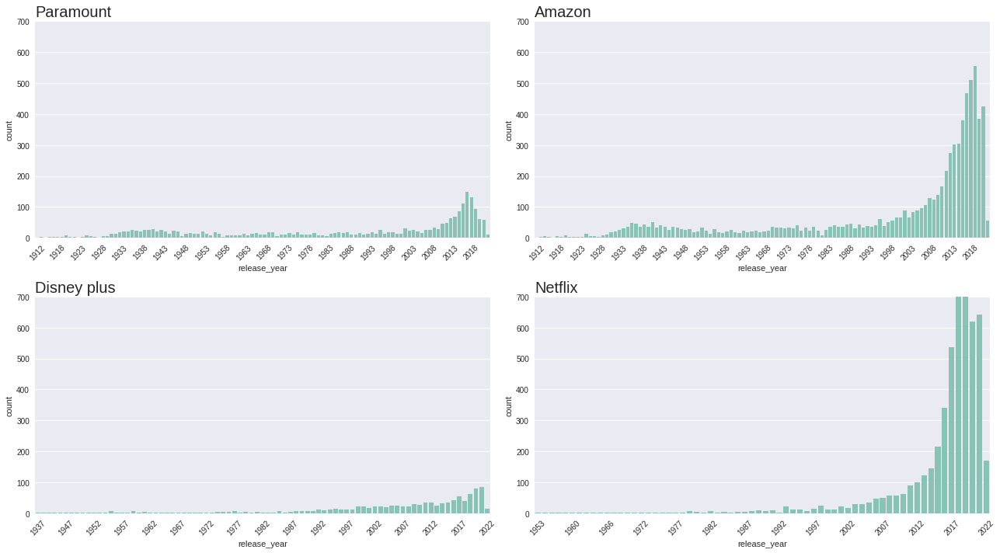

In [ ]:
fig, ax = plt.subplots(2,2, figsize=(18,10))
axes = ax.flatten()
print(list(set(df_title_result['Platform'])))
count = 0

for i in list(set(df_title_result['Platform'])):
  sns.countplot(data=df_title_result[df_title_result['Platform']==i], x='release_year', ax=axes[count],palette= ["#7fcdbb"])
  axes[count].set_xticklabels(axes[count].get_xticklabels(),rotation = 45)
  
  for a, tick in enumerate(axes[count].xaxis.get_ticklabels()):
    if a % 5 != 0:
        tick.set_visible(False)
  axes[count].set_ylim([0, 700]) 
  axes[count].set_title(i,fontsize=20, loc='left')
  count += 1 
   
plt.tight_layout()
plt.show()

### 장르별 분석

In [ ]:
genre_ohe = df_title_result.copy()

In [ ]:
import ast

genre_list = []
for i in list(set(genre_ohe['genres'])):
  x = ast.literal_eval(i)
  for a in x:
    genre_list.append(a)

set_genre_list = list(set(genre_list))
print(len(set_genre_list))

19


In [ ]:
set_genre_list

['european',
 'scifi',
 'comedy',
 'horror',
 'romance',
 'reality',
 'drama',
 'thriller',
 'music',
 'western',
 'fantasy',
 'history',
 'family',
 'war',
 'animation',
 'sport',
 'crime',
 'action',
 'documentation']

In [ ]:
for genre in set_genre_list:
  genre_ohe[genre] = 0

In [ ]:
genre_ohe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15672 entries, 0 to 15671
Data columns (total 35 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   id                    15672 non-null  object 
 1   title                 15672 non-null  object 
 2   type                  15672 non-null  object 
 3   description           15672 non-null  object 
 4   release_year          15672 non-null  int64  
 5   age_certification     15672 non-null  object 
 6   runtime               15672 non-null  int64  
 7   genres                15672 non-null  object 
 8   production_countries  15672 non-null  object 
 9   seasons               15672 non-null  float64
 10  imdb_id               15672 non-null  object 
 11  imdb_score            15672 non-null  float64
 12  imdb_votes            15672 non-null  float64
 13  tmdb_popularity       15672 non-null  float64
 14  tmdb_score            15672 non-null  float64
 15  Platform           

In [ ]:
for i in range(len(genre_ohe)):
    x = ast.literal_eval(genre_ohe['genres'].loc[i])
    for genre in x:
      genre_ohe[genre].loc[i] = 1      

In [ ]:
genre_ohe['genres'].loc[10]

"['animation', 'family', 'fantasy', 'romance', 'comedy']"

In [ ]:
genre_ohe.loc[10]

id                                                                tm89831
title                                                  Fun and Fancy Free
type                                                                MOVIE
description             Jiminy Cricket hosts two Disney animated short...
release_year                                                         1947
age_certification                                                       G
runtime                                                                73
genres                  ['animation', 'family', 'fantasy', 'romance', ...
production_countries                                               ['US']
seasons                                                               0.0
imdb_id                                                         tt0039404
imdb_score                                                            6.4
imdb_votes                                                         8228.0
tmdb_popularity                       

In [ ]:
genre_ohe

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,...,western,fantasy,history,family,war,animation,sport,crime,action,documentation
0,tm74391,Fantasia,MOVIE,Walt Disney's timeless masterpiece is an extra...,1940,G,120,"['animation', 'family', 'music', 'fantasy']",['US'],0.0,...,0,1,0,1,0,1,0,0,0,0
1,tm67803,Snow White and the Seven Dwarfs,MOVIE,"A beautiful girl, Snow White, takes refuge in ...",1937,G,83,"['fantasy', 'family', 'romance', 'animation', ...",['US'],0.0,...,0,1,0,1,0,1,0,0,0,0
2,tm82546,Pinocchio,MOVIE,Lonely toymaker Geppetto has his wishes answer...,1940,G,88,"['animation', 'comedy', 'family', 'fantasy']",['US'],0.0,...,0,1,0,1,0,1,0,0,0,0
3,tm79357,Bambi,MOVIE,Bambi's tale unfolds from season to season as ...,1942,G,70,"['animation', 'drama', 'family']",['US'],0.0,...,0,0,0,1,0,1,0,0,0,0
4,tm62671,Treasure Island,MOVIE,Enchanted by the idea of locating treasure bur...,1950,PG,96,"['family', 'action']","['GB', 'US']",0.0,...,0,0,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15667,tm1097142,My Bride,MOVIE,The story follows a young man and woman who go...,2021,No age certification,93,"['comedy', 'drama', 'romance']",['EG'],0.0,...,0,0,0,0,0,0,0,0,0,0
15668,tm878575,The Heartbreak Club,MOVIE,"Coping with heartbreak, the shy owner of floun...",2021,No age certification,101,"['comedy', 'drama', 'romance']",['ID'],0.0,...,0,0,0,0,0,0,0,0,0,0
15669,ts286386,The Big Day,SHOW,"For six engaged couples, happily ever after be...",2021,TV-MA,45,"['reality', 'romance']",['US'],2.0,...,0,0,0,0,0,0,0,0,0,0
15670,tm1004011,Time to Dance,MOVIE,When a ballroom dancer’s shot at a crucial tou...,2021,No age certification,107,"['drama', 'romance']",['IN'],0.0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
genre_ohe.groupby(['type']).sum()

,release_year,runtime,seasons,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,european,scifi,comedy,...,western,fantasy,history,family,war,animation,sport,crime,action,documentation
type,,,,,,,,,,,,,,,,,,,,,
MOVIE,24446076,1174578,0.0,72674.0,285605471.0,162112.911684,73409.2,1009,969,4614,...,559,1065,503,1367,432,582,364,1785,2550,1367
SHOW,6954464,127094,10230.0,24143.4,54582205.0,109932.231734,25614.5,225,681,1411,...,33,573,191,797,100,815,107,556,742,563


In [ ]:
platform_genre = genre_ohe.groupby(['Platform']).sum()
platform_genre = platform_genre.drop(list(set(platform_genre.columns)-set(set_genre_list)), axis=1)
platform_genre

,european,scifi,comedy,horror,romance,reality,drama,thriller,music,western,fantasy,history,family,war,animation,sport,crime,action,documentation
Platform,,,,,,,,,,,,,,,,,,,
Amazon,667,621,2456,909,1528,91,3845,1824,316,349,502,335,609,286,356,199,1098,1538,709
Disney plus,32,245,559,25,130,45,325,55,89,23,355,37,702,6,317,63,47,290,215
Netflix,439,544,2081,356,915,196,2668,1108,213,41,605,228,586,143,572,163,858,987,784
Paramount,96,240,929,253,451,84,988,491,124,179,176,94,267,97,152,46,338,477,222


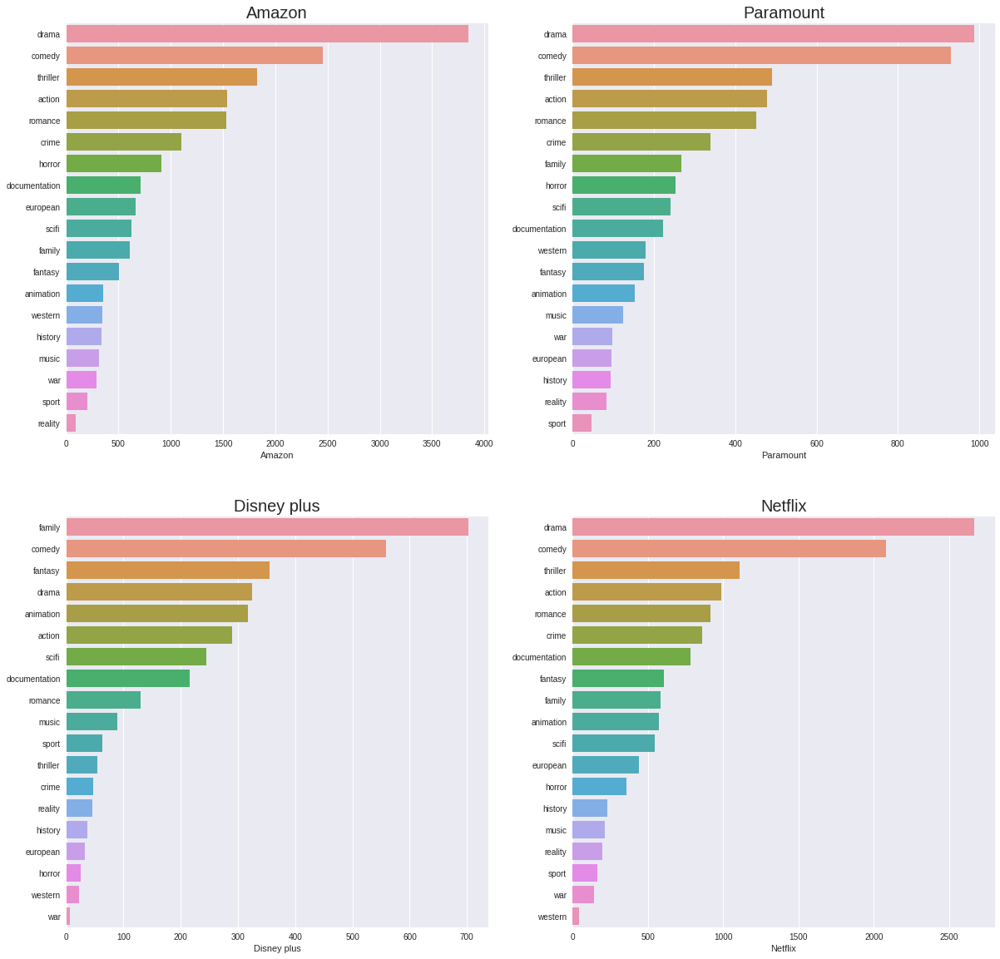

In [ ]:
def genre_frame(dataframe, platform):
  genre = dataframe.loc[platform]
  genre = pd.DataFrame(genre)
  return genre

platform_list = ['Amazon', 'Paramount', 'Disney plus', 'Netflix']


fig, ax = plt.subplots(2,2, figsize=(20,20))
axes = ax.flatten()

for i, platform in enumerate(platform_list):
  frame =  genre_frame(platform_genre, platform)
  sns.barplot(data=frame.reset_index().sort_values(platform, ascending=False), x=platform, y='index', ax=axes[i])
  axes[i].set_title(platform, fontsize=20)
  axes[i].set_ylabel("")



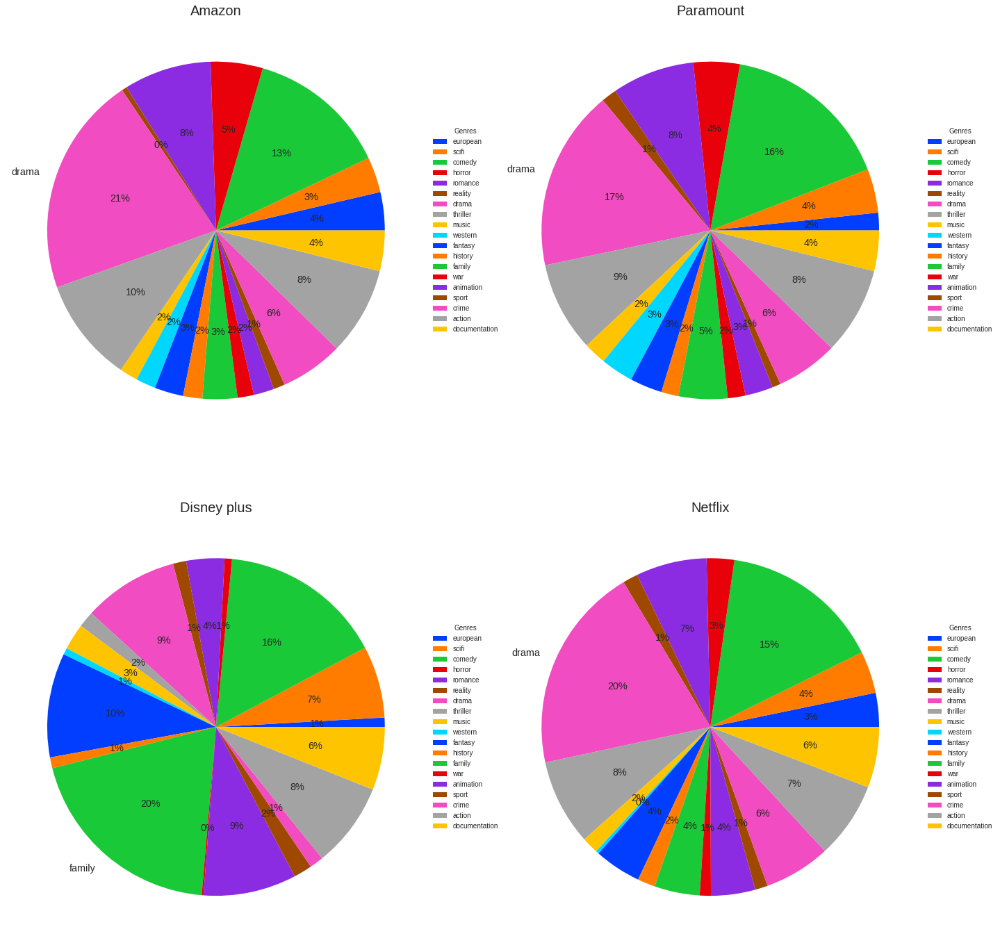

In [ ]:
colors = sns.color_palette('bright')


fig, ax = plt.subplots(2,2, figsize=(20,20))
axes = ax.flatten()

for i, platform in enumerate(platform_list):
  frame =  genre_frame(platform_genre, platform)
  data = list(frame[platform].values)
  labels = list(frame.reset_index()['index'])

  for n in range(len(data)):
    if data[n] != max(data):
      labels[n] = ''

  colors = sns.color_palette('bright')
  wedges, texts, autotexts = axes[i].pie(data, labels=labels, colors=colors, autopct = '%0.0f%%', textprops={'size': 'x-large'})
  axes[i].legend(wedges, list(frame.reset_index()['index']),
          title="Genres",
          loc="center left",
          bbox_to_anchor=(1, 0, 0.5, 1))

  axes[i].set_title(platform, fontsize=20)

plt.tight_layout()
plt.show()

### 국가별 분석

In [ ]:
country_ohe = df_title_result.copy()

In [ ]:
import ast

country_list = []
for i in list(set(country_ohe['production_countries'])):
  x = ast.literal_eval(i)
  for a in x:
    country_list.append(a)

set_country_list = list(set(country_list))

['CY',
 'HU',
 'RS',
 'PT',
 'PL',
 'PS',
 'SA',
 'DK',
 'FI',
 'IS',
 'AN',
 'SZ',
 'MU',
 'NL',
 'KE',
 'GL',
 'TW',
 'HK',
 'KI',
 'RU',
 'ZA',
 'US',
 'IL',
 'ES',
 'SUHH',
 'AL',
 'CD',
 'TR',
 'SO',
 'CM',
 'SV',
 'IT',
 'KR',
 'EG',
 'LT',
 'IQ',
 'ET',
 'SE',
 'BA',
 'UA',
 'TH',
 'KW',
 'BO',
 'LB',
 'AF',
 'QA',
 'XK',
 'JM',
 'CI',
 'CU',
 'CR',
 'BD',
 'AT',
 'MA',
 'NP',
 'MX',
 'SK',
 'EE',
 'ZW',
 'YU',
 'BM',
 'NO',
 'GT',
 'LU',
 'DZ',
 'AO',
 'IN',
 'TC',
 'GH',
 'CH',
 'GR',
 'FR',
 'PK',
 'VE',
 'GQ',
 'TT',
 'DE',
 'FO',
 'PA',
 'DO',
 'Lebanon',
 'TN',
 'MZ',
 'CL',
 'GE',
 'CO',
 'SN',
 'MC',
 'AR',
 'ID',
 'BE',
 'CN',
 'NZ',
 'XX',
 'BR',
 'LV',
 'TZ',
 'HR',
 'SI',
 'CA',
 'NG',
 'IO',
 'XC',
 'IE',
 'JO',
 'PR',
 'SG',
 'AU',
 'AE',
 'VA',
 'KH',
 'SY',
 'UG',
 'PY',
 'LI',
 'GB',
 'PH',
 'MY',
 'MT',
 'SU',
 'BG',
 'CZ',
 'PE',
 'UY',
 'IR',
 'BS',
 'MN',
 'BF',
 'JP',
 'United States of America',
 'MW',
 'VN',
 'KZ',
 'RO']

In [ ]:
for country in set_country_list:
  if country == 'United States of America':
    country_ohe['US'] = 0
  elif country == 'Lebanon':
    country_ohe['LB'] = 0
  else:
    country_ohe[country] = 0

In [ ]:
for i in range(len(country_ohe)):
    x = ast.literal_eval(country_ohe['production_countries'].loc[i])
    for country in x:
      if country == 'United States of America':
         country_ohe['US'].loc[i] = 1
      elif country == 'Lebanon':
         country_ohe['LB'].loc[i] = 1
      else:
         country_ohe[country].loc[i] = 1

country_ohe

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,...,UY,IR,BS,MN,BF,JP,MW,VN,KZ,RO
0,tm74391,Fantasia,MOVIE,Walt Disney's timeless masterpiece is an extra...,1940,G,120,"['animation', 'family', 'music', 'fantasy']",['US'],0.0,...,0,0,0,0,0,0,0,0,0,0
1,tm67803,Snow White and the Seven Dwarfs,MOVIE,"A beautiful girl, Snow White, takes refuge in ...",1937,G,83,"['fantasy', 'family', 'romance', 'animation', ...",['US'],0.0,...,0,0,0,0,0,0,0,0,0,0
2,tm82546,Pinocchio,MOVIE,Lonely toymaker Geppetto has his wishes answer...,1940,G,88,"['animation', 'comedy', 'family', 'fantasy']",['US'],0.0,...,0,0,0,0,0,0,0,0,0,0
3,tm79357,Bambi,MOVIE,Bambi's tale unfolds from season to season as ...,1942,G,70,"['animation', 'drama', 'family']",['US'],0.0,...,0,0,0,0,0,0,0,0,0,0
4,tm62671,Treasure Island,MOVIE,Enchanted by the idea of locating treasure bur...,1950,PG,96,"['family', 'action']","['GB', 'US']",0.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15667,tm1097142,My Bride,MOVIE,The story follows a young man and woman who go...,2021,No age certification,93,"['comedy', 'drama', 'romance']",['EG'],0.0,...,0,0,0,0,0,0,0,0,0,0
15668,tm878575,The Heartbreak Club,MOVIE,"Coping with heartbreak, the shy owner of floun...",2021,No age certification,101,"['comedy', 'drama', 'romance']",['ID'],0.0,...,0,0,0,0,0,0,0,0,0,0
15669,ts286386,The Big Day,SHOW,"For six engaged couples, happily ever after be...",2021,TV-MA,45,"['reality', 'romance']",['US'],2.0,...,0,0,0,0,0,0,0,0,0,0
15670,tm1004011,Time to Dance,MOVIE,When a ballroom dancer’s shot at a crucial tou...,2021,No age certification,107,"['drama', 'romance']",['IN'],0.0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
country_ohe.loc[10].values

array(['tm89831', 'Fun and Fancy Free', 'MOVIE',
       'Jiminy Cricket hosts two Disney animated shorts: “Bongo,” about a circus bear escaping to the wild, and “Mickey and the Beanstalk,” a take on the famous fairy tale.',
       1947, 'G', 73,
       "['animation', 'family', 'fantasy', 'romance', 'comedy']",
       "['US']", 0.0, 'tt0039404', 6.4, 8228.0, 10.058, 6.3,
       'Disney plus', 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0], dtype=object)

In [ ]:
platform_country = country_ohe.groupby(['Platform']).sum()
platform_country = platform_country.drop(list(set(platform_country.columns)-set(set_country_list)), axis=1)
platform_country

,CY,HU,RS,PT,PL,PS,SA,DK,FI,IS,...,UY,IR,BS,MN,BF,JP,MW,VN,KZ,RO
Platform,,,,,,,,,,,,,,,,,,,,,
Amazon,1,7,5,4,17,2,0,22,8,5,...,4,8,0,3,0,164,0,3,2,8
Disney plus,0,1,0,0,1,0,0,2,0,0,...,0,0,0,0,0,7,0,0,0,0
Netflix,1,6,2,5,38,11,9,25,7,10,...,7,2,1,0,1,257,1,2,0,6
Paramount,0,0,0,0,1,0,0,1,1,0,...,0,0,0,0,0,10,0,0,0,1


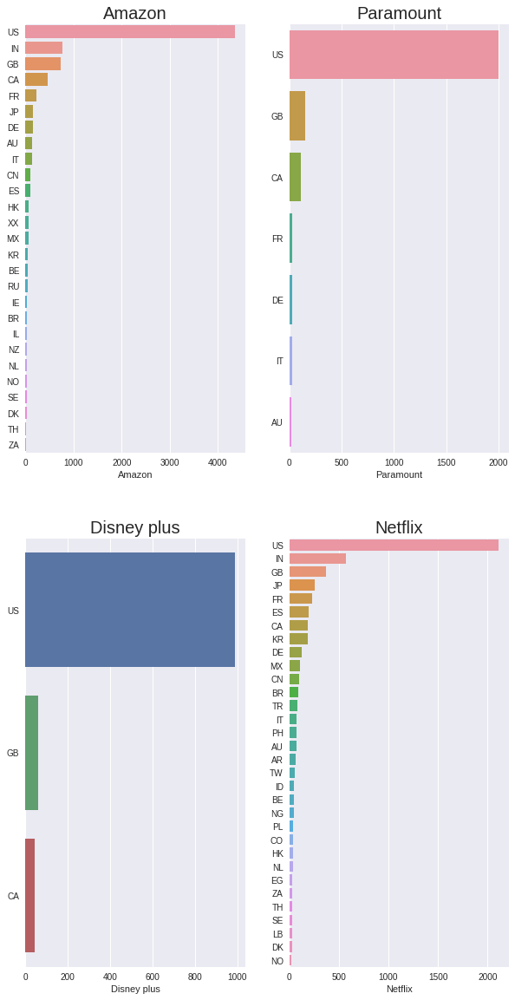

In [ ]:
platform_list = ['Amazon', 'Paramount', 'Disney plus', 'Netflix']

def country_frame(dataframe, platform, threshold):
  country = dataframe.loc[platform]
  country = pd.DataFrame(country)
  index = country[country[platform] < threshold].index
  country = country.drop(index)
  return country

fig, ax = plt.subplots(2,2, figsize=(10,20))
axes = ax.flatten()

for i, platform in enumerate(platform_list):
  frame =  country_frame(platform_country, platform, 20)
  sns.barplot(data=frame.reset_index().sort_values(platform, ascending=False), x=platform, y='index', ax=axes[i])
  axes[i].set_title(platform, fontsize=20)
  axes[i].set_ylabel("")

### 플랫폼 별 콘텐츠 공유 비율

In [ ]:
df_title_result['id'].nunique()

14087

In [ ]:
df_title_result['id'].unique()

array(['tm74391', 'tm67803', 'tm82546', ..., 'ts286386', 'tm1004011',
       'ts271048'], dtype=object)

In [ ]:
platforms = ['Netflix', 'Amazon', 'Disney plus', 'Paramount']

In [ ]:
for platform in platforms:
  print((df_title_result['Platform'] == platform).sum())

5041
7317
1057
2257


In [ ]:
set_uni_id = []
uni_plat = []

for platform in platforms:
  df_masked = df_title_result[df_title_result['Platform'] == platform]

  tmp = set(df_masked['id'])
  other = set(df_title_result[df_title_result['Platform'] != platform]['id'])

  diff = tmp - other
  set_uni_id.append(np.array(list(diff)))

  a = df_masked[df_masked['id'].isin(list(diff))]
  uni_plat.append(a)

In [ ]:
for uni in uni_plat:
  print(uni['imdb_score'].describe())
  print(); print()

count    4870.000000
mean        6.533470
std         1.150103
min         1.600000
25%         5.800000
50%         6.600000
75%         7.400000
max         9.500000
Name: imdb_score, dtype: float64


count    5796.000000
mean        6.009903
std         1.346109
min         1.100000
25%         5.200000
50%         6.100000
75%         7.000000
max         9.900000
Name: imdb_score, dtype: float64


count    1049.000000
mean        6.592278
std         1.056427
min         1.600000
25%         5.900000
50%         6.600000
75%         7.300000
max         9.700000
Name: imdb_score, dtype: float64


count    798.000000
mean       6.543358
std        1.264951
min        1.700000
25%        5.800000
50%        6.700000
75%        7.400000
max        9.400000
Name: imdb_score, dtype: float64




In [ ]:
for plat, df in zip(set_uni_id, platforms):
  original = (df_title_result['Platform'] == df).sum()
  uni = plat.shape[0]

  print(f'{df}')
  print(original)
  print(f'unique : {uni}')
  print(f'difference : {original - uni}')
  print()

Netflix
5041
unique : 4870
difference : 171

Amazon
7317
unique : 5795
difference : 1522

Disney plus
1057
unique : 1049
difference : 8

Paramount
2257
unique : 798
difference : 1459



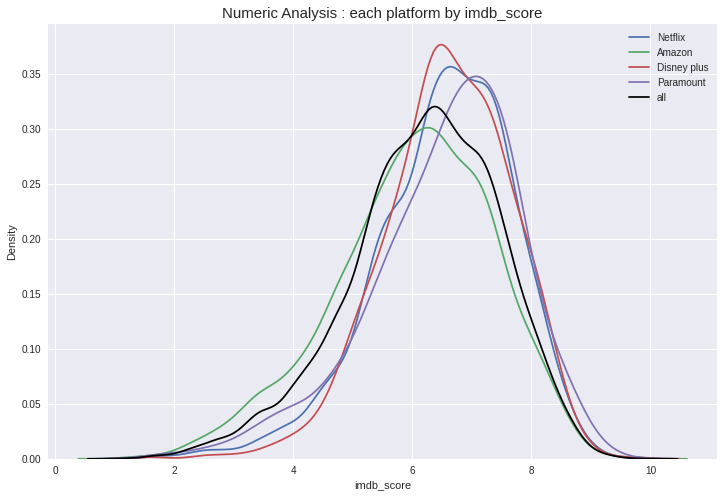

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
plt.title('Numeric Analysis : each platform by imdb_score', size=15)


for uni, plat in zip(uni_plat, platforms):
  sns.distplot(uni['imdb_score'], hist=False, ax=ax, label=plat)

sns.distplot(df_title_result['imdb_score'], hist=False, ax=ax, color='black', label='all')
plt.legend()
plt.show()

In [ ]:
for uni in uni_plat:
  print(uni['tmdb_score'].describe())
  print(); print()

count    4870.000000
mean        6.807598
std         1.144191
min         1.000000
25%         6.100000
50%         6.900000
75%         7.500000
max        10.000000
Name: tmdb_score, dtype: float64


count    5796.000000
mean        6.070600
std         1.515839
min         0.800000
25%         5.300000
50%         6.100000
75%         7.000000
max        10.000000
Name: tmdb_score, dtype: float64


count    1049.000000
mean        6.980458
std         1.056084
min         1.000000
25%         6.300000
50%         7.000000
75%         7.700000
max        10.000000
Name: tmdb_score, dtype: float64


count    798.000000
mean       6.822807
std        1.434546
min        1.000000
25%        6.100000
50%        7.000000
75%        7.700000
max       10.000000
Name: tmdb_score, dtype: float64




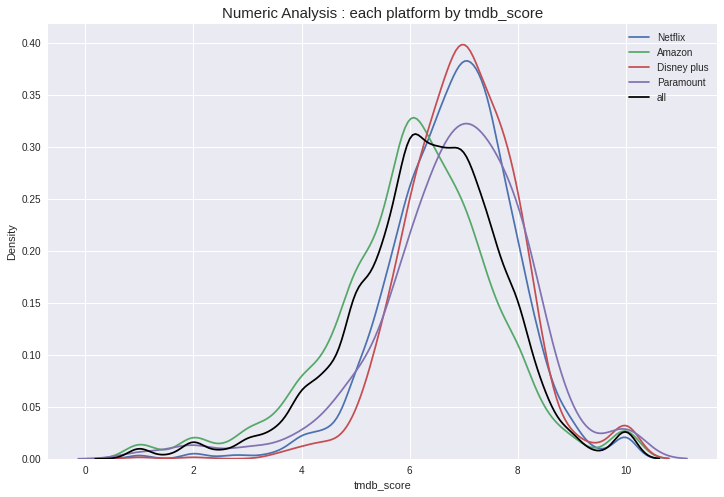

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
plt.title('Numeric Analysis : each platform by tmdb_score', size=15)


for uni, plat in zip(uni_plat, platforms):
  sns.distplot(uni['tmdb_score'], hist=False, ax=ax, label=plat)

sns.distplot(df_title_result['tmdb_score'], hist=False, ax=ax, color='black', label='all')
plt.legend()
plt.show()

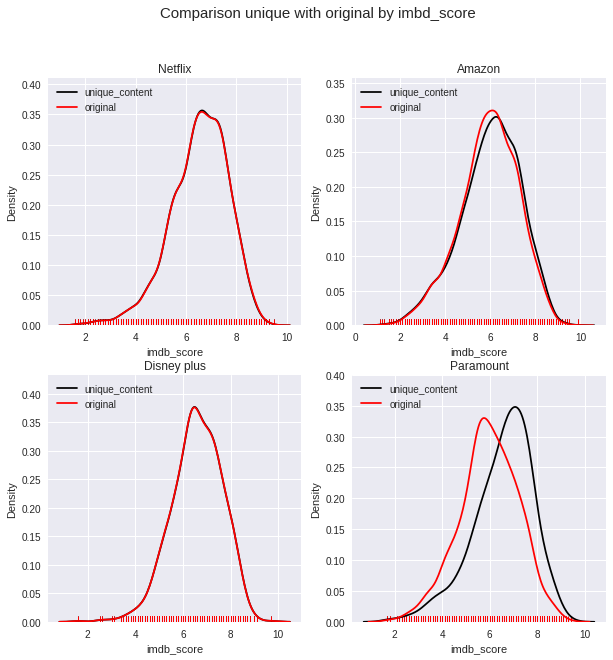

In [ ]:
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax = ax.flatten()
plt.suptitle('Comparison unique with original by imbd_score', size=15)

for idx, (uni, platform) in enumerate(zip(uni_plat, platforms)):
  ax[idx].set_title(platform, size=12)
  # print(uni.shape)
  sns.distplot(uni['imdb_score'], rug=True, hist=False, ax=ax[idx], label='unique_content', color='black')
  sns.distplot(df_title_result[df_title_result['Platform'] == platform]['imdb_score'], rug=True, hist=False, ax=ax[idx], label='original', color='red')
  ax[idx].legend()

plt.show()

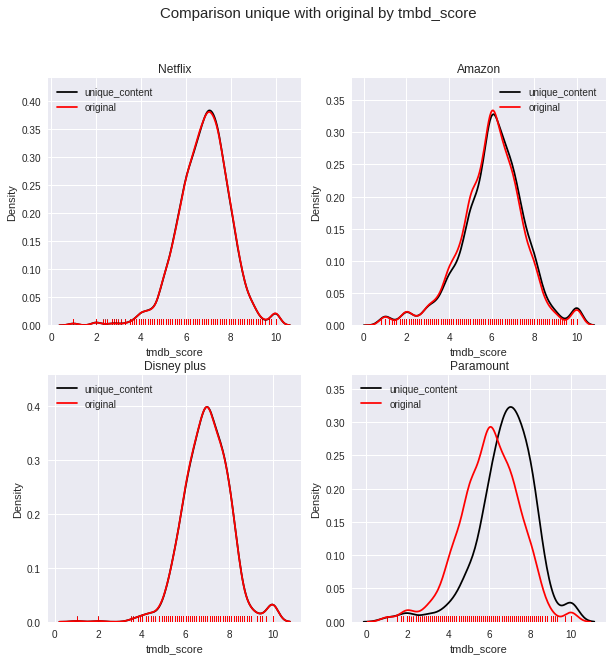

In [ ]:
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax = ax.flatten()
plt.suptitle('Comparison unique with original by tmbd_score', size=15)

for idx, (uni, platform) in enumerate(zip(uni_plat, platforms)):
  ax[idx].set_title(platform, size=12)
  sns.distplot(uni['tmdb_score'], rug=True, hist=False, ax=ax[idx], label='unique_content', color='black')
  sns.distplot(df_title_result[df_title_result['Platform'] == platform]['tmdb_score'], rug=True, hist=False, ax=ax[idx], label='original', color='red')
  ax[idx].legend()

plt.show()

## 평점 데이터 분석

### imdb vs tmdb (score)

<Figure size 1440x1440 with 0 Axes>

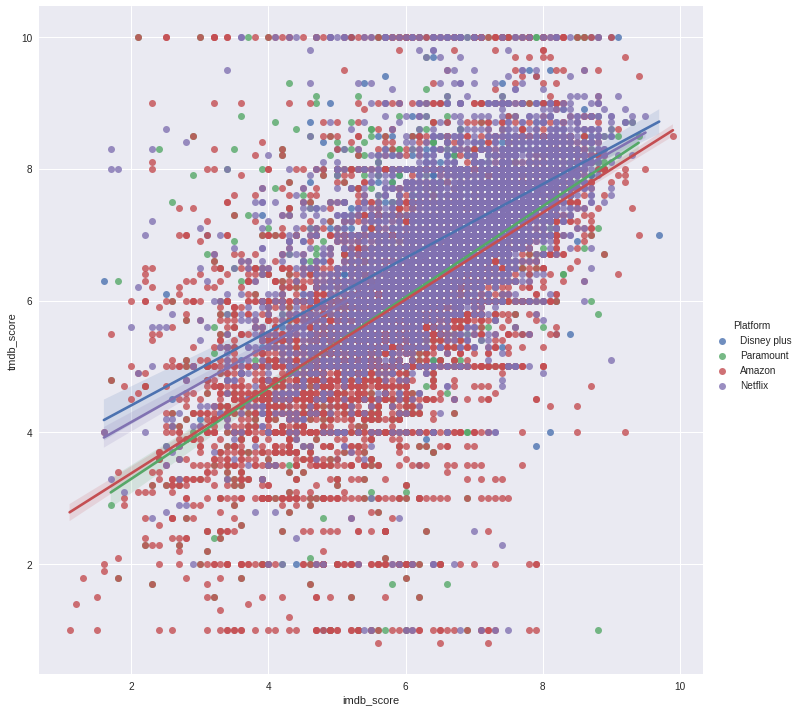

In [ ]:
# 플랫폼별 score 추이
plt.figure(figsize=(20,20))
sns.lmplot(x='imdb_score', y='tmdb_score', height=10, hue='Platform',
           legend_out='True', data=df_title_result)
plt.show()

imdb와 tmdb score는 전반적으로 비슷한 상관관계를 보인다.

넷플릭스와 디즈니의 콘텐츠 중에는 한쪽 스코어가 낮은데 다른쪽 스코어가 높은 경우도 꽤 보이고 있다.

반대로 파라마운트와 아마존은 상대적으로 범용적인 콘텐츠를 많이 가지고 있음을 알 수 있다.

전반적으로 디즈니의 콘텐츠들이 좋은 평가를 받고 있다.

세간의 인식과 비슷하게, 점수만 놓고 보면 넷플릭스가 디즈니와 경쟁할만하다.

### tmdb_popularity 분포

<Figure size 720x1080 with 0 Axes>

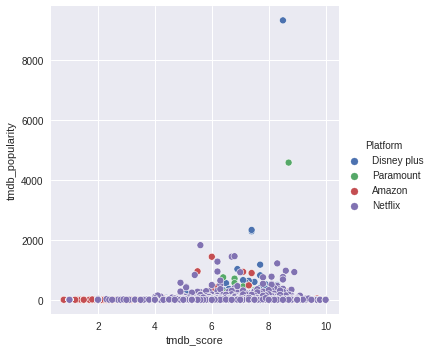

In [ ]:
# 플랫폼별 tmdb_pop
plt.figure(figsize=(10,15))
sns.relplot(x='tmdb_score', y='tmdb_popularity', hue='Platform', data=df_title_result)
plt.show()

파라마운트와 디즈니 쪽에서 이상치가 발견됨. 확인해보자

In [ ]:
df_title_result.loc[df_title_result['tmdb_popularity'] > 4000]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
958,ts219003,Moon Knight,SHOW,"When Steven Grant, a mild-mannered gift-shop e...",2022,TV-14,48,"['action', 'scifi', 'drama', 'fantasy', 'horro...",['US'],1.0,tt10234724,7.5,128362.0,9323.832,8.5,Disney plus
3247,ts43075,Halo,SHOW,Depicting an epic 26th-century conflict betwee...,2022,TV-14,52,"['scifi', 'thriller', 'war', 'action']",['US'],1.0,tt2934286,7.1,31375.0,4579.160,8.7,Paramount


최신 콘텐츠들이다. 제외하고 다시 그래프를 그려본다.

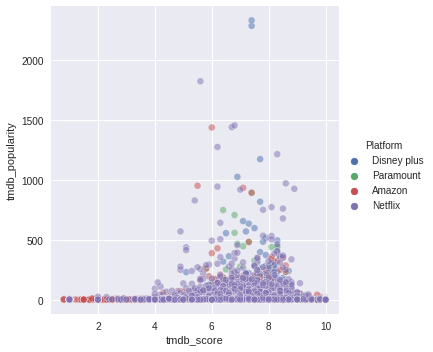

In [ ]:
popularity_check = df_title_result.loc[df_title_result['tmdb_popularity'] <= 4000]

sns.relplot(x='tmdb_score', y='tmdb_popularity', hue='Platform', data=popularity_check, alpha=0.5)

<Figure size 1440x1440 with 0 Axes>

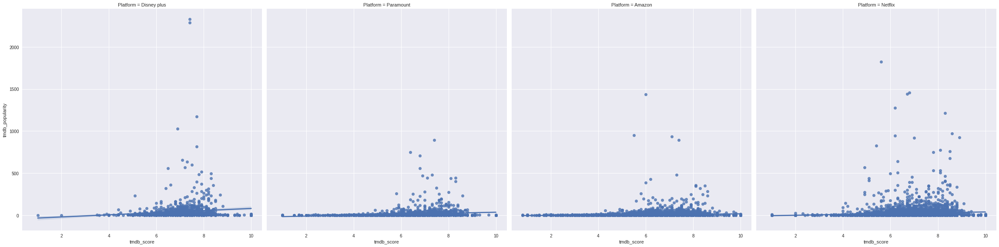

In [ ]:
plt.figure(figsize=(20,20))
sns.lmplot(data=popularity_check, x='tmdb_score', y='tmdb_popularity', height=8, legend_out='True', col='Platform')
plt.show()

대부분의 콘텐츠가 6~9점 사이에 몰려 있다.

pop 수치가 500, 800 이상이냐에 따라 인기 or 초대박을 구분할 수 있을 듯하다.

In [ ]:
is_this_popular = df_title_result.loc[(df_title_result['tmdb_popularity'] > 500) & (df_title_result['tmdb_popularity'] < 800)]
is_this_megahit = df_title_result.loc[(df_title_result['tmdb_popularity'] >= 800) & (df_title_result['tmdb_popularity'] < 4000)]

print('Done!')

Done!


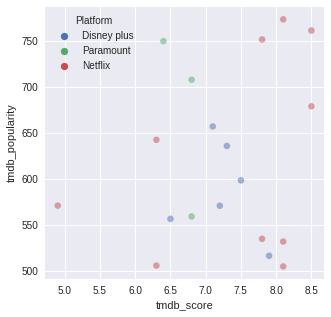

In [ ]:
plt.figure(figsize=(5,5))
sns.scatterplot(x='tmdb_score', y='tmdb_popularity', hue='Platform', data=is_this_popular, alpha=0.5)
plt.show()

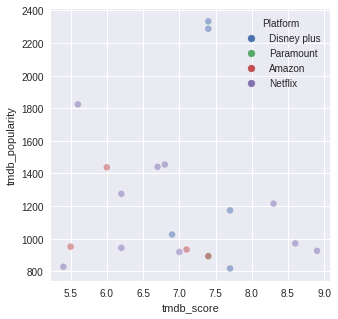

In [ ]:
plt.figure(figsize=(5,5))
sns.scatterplot(x='tmdb_score', y='tmdb_popularity', hue='Platform', data=is_this_megahit, alpha=0.5)
plt.show()

확실히 디즈니 플러스와 넷플릭스가 킬러 콘텐츠를 많이 가지고 있다.

아마존은 500~800 사이에는 거의 없지만 800이상에서 의외의 킬러 콘텐츠 몇 개를 보유하고 있다.

### 플랫폼별 imdb_vote

그런데 imdb 쪽으로 가면 상황이 달라진다.

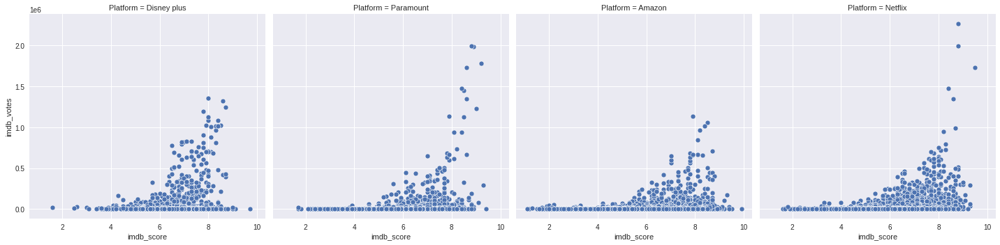

In [ ]:
sns.relplot(data=df_title_result, x='imdb_score', y='imdb_votes',  height=5, col='Platform')

디즈니와 아마존이 보유한 콘텐츠들은 파라마운트와 넷플릭스가 보유한 콘텐츠들에 비해 상대적으로 imdb 평가 체계에서 좋은 평가를 받지 못하고 있다.

(파라마운트와 넷플릭스는 분포가 오른쪽으로 더 치우쳐져 있음)

혹은 imdb에서 좋은 평가를 받는 콘텐츠를 디즈니와 아마존이 확보하지 못했다는 의미도 될 수 있다.

### imdb와 tmdb 누굴 믿어야 하나?

<Figure size 1440x1440 with 0 Axes>

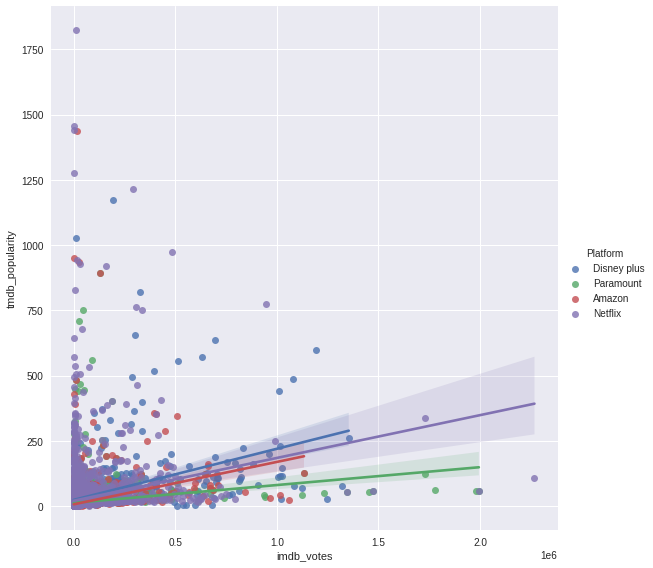

In [ ]:
# imdb 스코어 & 투표 수

# 이상치 제거
pop_votes = df_title_result.loc[(df_title_result['tmdb_popularity']<2000)]

plt.figure(figsize=(20,20))
sns.lmplot(data=pop_votes, x='imdb_votes', y='tmdb_popularity', height=8, legend_out='True', hue='Platform')
plt.show()

imdb, tmdb 어느 쪽이든 전반적으로 디즈니의 콘텐츠가 인기가 많은 것은 틀림없다.

넷플릭스 정도는 돼야 디즈니와 콘텐츠 pool로 경쟁할만한 것도 확인할 수 있다.

넷플릭스와 아마존의 콘텐츠 pool에 대한 관심은 거의 비슷하게 분포한다.

<Figure size 1440x1440 with 0 Axes>

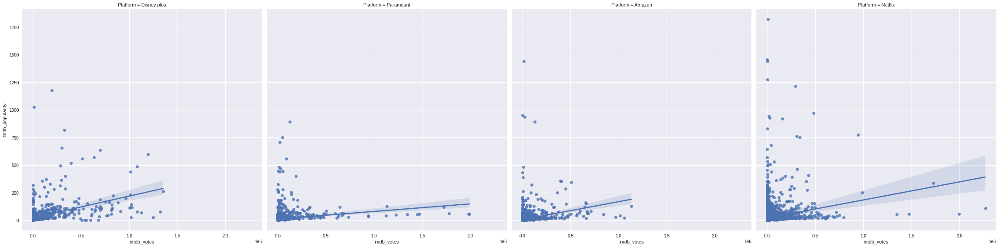

In [ ]:
plt.figure(figsize=(20,20))
sns.lmplot(data=pop_votes, x='imdb_votes', y='tmdb_popularity', height=8, legend_out='True', col='Platform')
plt.show()

그래프를 보면 아마존과 넷플릭스의 분포도 크게 다르지 않다.

디즈니는 자사 콘텐츠에 집중해서 그런지 아주 높은 점수대의 작품이 적고,

파라마운트는 인기는 적지만 투표율이 높은 콘텐츠가 다수 존재한다. (= 인기는 없지만 마니악하거나 잘 만든 명작 콘텐츠일 확률 높음)

넷플릭스는 콘텐츠 종류를 거의 가리지 않고 똥작부터 명작까지 두루 섭렵중인것 같고,

아마존은 넷플릭스와 비슷하지만 상대적으로 점수 분포가 낮다.

콘텐츠 숫자는 아마존이 제일 많음에도 불구하고 점수 분포가 낮다는 것은 크게 2가지로 해석할 수 있다.

1) 넷플릭스 오리지널 콘텐츠가 고평가를 받고 있는 경우

2) 아마존 데이터가 누락된 경우 (특히 imdb_votes)


### imdb_votes가 높으면 명작이다?

- imdb_votes는 계정당 1개의 영화에 1개만 작성할 수 있다. 따라서 popularity가 낮더라도 votes가 높다면 그만큼 많은 사람들이 찾아와서 평가를 작성한다는 의미가 된다.

- 즉, "imdb_votes가 높으면 명작" 이라는 가설을 세울 수 있다.

In [ ]:
vote_high = df_title_result.loc[(df_title_result['imdb_votes']>1500000)]

len(vote_high)

7

최상위권에는 총 7개의 콘텐츠가 있다. 위 그래프의 분포를 보니 아마 파라마운트와 넷플릭스에서 볼 수 있는 콘텐츠들일 것이다.

In [ ]:
vote_high['Platform']

1510     Paramount
1991     Paramount
1995     Paramount
2484     Paramount
10728      Netflix
10856      Netflix
10873      Netflix
Name: Platform, dtype: object

In [ ]:
vote_high['title']

1510     The Godfather
1991      Pulp Fiction
1995      Forrest Gump
2484      Interstellar
10728     Forrest Gump
10856     Breaking Bad
10873        Inception
Name: title, dtype: object

대부, 펄프픽션, 포레스트 검프, 인터스텔라, 브레이킹 배드, 인셉션

모두 명작으로 칭송받는 영화들이다.

imdb_votes가 높으면 명작이라는 가설을 확인했다.

### tmdb_pop이 높아도 명작인가?

In [ ]:
tmdb_high = df_title_result.loc[(df_title_result['tmdb_popularity']>800)]

len(tmdb_high)

22

In [ ]:
tmdb_high['title']

642                                 Doctor Strange
958                                    Moon Knight
962                                    Turning Red
966                                        Encanto
970      Shang-Chi and the Legend of the Ten Rings
995            The Ice Age Adventures of Buck Wild
3092                            Sonic the Hedgehog
3247                                          Halo
9209                            Sonic the Hedgehog
10156                           All the Old Knives
10179            Hotel Transylvania: Transformania
10246                                       Harina
10691                             Wheel of Fortune
10860                               Grey's Anatomy
11453                               Peaky Blinders
14860                                 Heartstopper
14862                             The Adam Project
14891                                   Black Crab
14895                           365 Days: This Day
14900                          

tmdb_popularity는 인기 순위, 특히 최근 '화제작'의 개념에 가깝다는 것을 알 수 있다.

### 데이터 누락?

앞서 살펴본 imdb_votes 수치가 높은 작품들은 명작들이다.

그런데 이런 명작들이 왜 아마존과 디즈니에는 없을까?

데이터 누락이 의심된다. 한번 확인해보자.

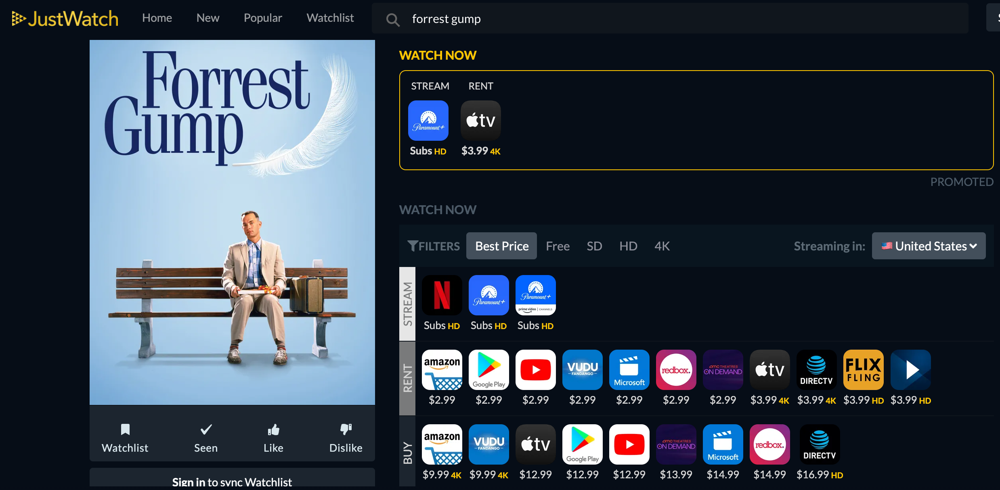


분명히 존재한다. 전처리가 잘못된 걸까?

In [ ]:
ori_amz = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Datathone/Amazon/titles.csv')

ori_amz.loc[(ori_amz['title'] == 'Forrest Gump')]

,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score


전처리 과정의 문제가 아니라 원본 데이터가 온전하지 않음을 확인했다. 

특히 앞에서 본 imdb_votes 데이터가 누락되었을 가능성이 높다.

데이터 전체 프로파일링을 해보자.

(오류 발생, pandas_profilling 사용)

## 개별 title 분석

### 1) Amazon

In [ ]:
amazon_titles_Report = ProfileReport(title_dataframe['Amazon'], title="Pandas Profiling Report", explorative=True)
amazon_titles_Report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### 2) Netflix

In [ ]:
netflix_titles_Report = ProfileReport(title_dataframe['Netflix'], title="Pandas Profiling Report", explorative=True)
netflix_titles_Report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### 3) Paramount

In [ ]:
paramount_titles_Report = ProfileReport(title_dataframe['Paramount'], title="Pandas Profiling Report", explorative=True)
paramount_titles_Report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### 4) Disney plus

In [ ]:
disney_titles_Report = ProfileReport(title_dataframe['Disney plus'], title="Pandas Profiling Report", explorative=True)
disney_titles_Report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# \----------------------------------------

# 스탯 계산

In [ ]:
id_dict = {}
for id in list(set(df_title_result['id'])):
  id_dict[id] = []


for i in range(len(df_title_result)):  
  id_dict[df_title_result.loc[i]['id']].append(df_title_result.loc[i]['Platform'])


## 1) uniqueness




### 1) Amazon

In [ ]:
amazon_one_list = []

for i in id_dict:
  if len(id_dict[i]) == 1:
    if 'Amazon' in id_dict[i]:
      amazon_one_list.append(i)      

In [ ]:
print(amazon_one_list)

['tm39382', 'tm45967', 'tm12458', 'tm456163', 'tm175151', 'tm76257', 'tm950313', 'tm39764', 'tm356745', 'tm901292', 'tm170380', 'tm90672', 'ts216926', 'ts27022', 'tm372754', 'tm191983', 'tm77267', 'tm79354', 'tm48336', 'tm461891', 'tm485701', 'tm39116', 'tm7180', 'tm65210', 'tm1035107', 'tm950146', 'tm145141', 'tm33711', 'tm452025', 'tm480068', 'tm115143', 'tm372237', 'tm196365', 'tm120566', 'tm59548', 'tm179361', 'tm215725', 'tm194833', 'tm143654', 'tm109165', 'ts314009', 'tm181617', 'tm92833', 'tm161275', 'tm1042882', 'tm165411', 'tm131900', 'tm359912', 'tm37384', 'tm94865', 'tm152137', 'tm326367', 'tm177696', 'tm49708', 'tm43898', 'tm964877', 'tm168606', 'tm1108724', 'tm161073', 'tm307408', 'tm214982', 'tm64177', 'tm307983', 'tm814728', 'tm160633', 'tm242804', 'tm138701', 'tm37147', 'tm998256', 'ts24110', 'tm79348', 'tm68396', 'tm180456', 'tm220396', 'ts7221', 'tm17639', 'tm35425', 'tm188058', 'ts34845', 'tm105531', 'tm357562', 'tm161526', 'tm486202', 'ts21102', 'ts21623', 'tm184743

### 2) Netflix

In [ ]:
netflix_one_list = []

for i in id_dict:
  if len(id_dict[i]) == 1:
    if 'Netflix' in id_dict[i]:
      netflix_one_list.append(i)      

### 3) Paramount

In [ ]:
paramount_one_list = []

for i in id_dict:
  if len(id_dict[i]) == 1:
    if 'Paramount' in id_dict[i]:
      paramount_one_list.append(i)

### 4) Disney plus

In [ ]:
disney_one_list = []

for i in id_dict:
  if len(id_dict[i]) == 1:
    if 'Disney plus' in id_dict[i]: 
      disney_one_list.append(i)

In [ ]:
print(f'disney : {len(disney_one_list)}')
print(f'amazon : {len(amazon_one_list)}')
print(f'paramount : {len(paramount_one_list)}')
print(f'netflix : {len(netflix_one_list)}')

disney : 1049
amazon : 5794
paramount : 798
netflix : 4870


#### Total score.

In [ ]:
# print(f'amazon : {len(amazon_one_list)} / amazon whole number : {len(df_amazon_titles)}')
print(f'amazon : {len(amazon_one_list) / len(title_dataframe["Amazon"]) * 100:.2f}%')

# print(f'netflix : {len(netflix_one_list)} / netflix whole number : {len(df_netflix_titles)}')
print(f'netflix : {len(netflix_one_list) / len(title_dataframe["Netflix"]) * 100:.2f}%')

# print(f'paramount : {len(paramount_one_list)} / paramount whole number : {len(df_paramount_titles)}')
print(f'paramount : {len(paramount_one_list) / len(title_dataframe["Paramount"]) * 100:.2f}%')

# print(f'disney : {len(disney_one_list)} / disney whole number : {len(df_disney_titles)}')
print(f'disney : {len(disney_one_list) / len(title_dataframe["Disney plus"]) * 100:.2f}%')


amazon_pop = len(amazon_one_list) / len(title_dataframe["Amazon"])
netflix_pop = len(netflix_one_list) / len(title_dataframe["Netflix"])
paramount_pop = len(paramount_one_list) / len(title_dataframe["Paramount"])
disney_pop = len(disney_one_list) / len(title_dataframe["Disney plus"])

print(amazon_pop)

amazon : 79.19%
netflix : 96.61%
paramount : 35.36%
disney : 99.24%
0.7918545852125188


In [ ]:
total_score = {}
total_score['uniqueness'] = {'Amazon':round((amazon_pop/disney_pop*10),2),
                             'Netflix':round((netflix_pop/disney_pop*10),2),
                             'Paramount':round((paramount_pop/disney_pop*10),2),
                             'Disney plus':round((disney_pop/disney_pop*10), 2)}

In [ ]:
total_score['uniqueness']

{'Amazon': 7.98, 'Disney plus': 10.0, 'Netflix': 9.73, 'Paramount': 3.56}


## 2) popularity



In [ ]:
disney_list = []
amazon_list = []
paramount_list = []
netflix_list = []

for i in id_dict:
  if len(id_dict[i]) > 1:
    if 'Disney plus' in id_dict[i]: 
      disney_list.append(i)
      
      
for i in id_dict:
  if len(id_dict[i]) > 1:
    if 'Amazon' in id_dict[i]:
      amazon_list.append(i)
      

for i in id_dict:
  if len(id_dict[i]) > 1:
    if 'Paramount' in id_dict[i]:
      paramount_list.append(i)
      


for i in id_dict:
  if len(id_dict[i]) > 1:
    if 'Netflix' in id_dict[i]:
      netflix_list.append(i)      

### 1) Amazon

In [ ]:
amazon_pop = []
df_amazon_titles = title_dataframe['Amazon']
for id in amazon_list:
  amazon_pop.append(df_amazon_titles[(df_amazon_titles['id']==id) & (df_amazon_titles['imdb_score'] > 3) &  (df_amazon_titles['tmdb_score'] > 3)])

print(f'amazon pop number : {len(amazon_pop)}')
print(f'amazon whole number : {len(df_amazon_titles)}')

amazon_pop_score = 0

for content in amazon_pop:
  amazon_pop_score += content['tmdb_popularity'].sum()

print(amazon_pop_score)

amazon pop number : 1522
amazon whole number : 7317
12226.613999999998


In [ ]:
df_amazon_titles['imdb_score']

0       8.6
1       8.2
2       8.1
3       7.8
4       7.9
       ... 
9843    7.3
9844    5.4
9847    2.8
9856    6.8
9864    4.0
Name: imdb_score, Length: 7317, dtype: float64

### 2) Netflix

In [ ]:
netflix_pop = []
df_netflix_titles = title_dataframe["Netflix"]
for id in netflix_list:
  
  netflix_pop.append(df_netflix_titles[(df_netflix_titles['id']==id) & (df_netflix_titles['imdb_score'] > 3) & (df_netflix_titles['tmdb_score'] > 3)])

netflix_pop_score = 0
for content in netflix_pop:
  netflix_pop_score += content['tmdb_popularity'].sum()



### 3) Paramount

In [ ]:
paramount_pop = []
df_paramount_titles = title_dataframe["Paramount"]
for id in paramount_list:
  paramount_pop.append(df_paramount_titles[(df_paramount_titles['id']==id) & (df_paramount_titles['imdb_score'] > 3) & (df_paramount_titles['tmdb_score'] > 3)])

print(f'paramount pop number : {len(paramount_pop)}')
print(f'paramount whole number : {len(df_paramount_titles)}')

paramount_pop_score = 0
for content in paramount_pop:
  paramount_pop_score += content['tmdb_popularity'].sum()

print(paramount_pop_score)

paramount pop number : 1459
paramount whole number : 2257
12555.945999999996


### 4) Disney plus

In [ ]:
disney_pop = []
df_disney_titles = title_dataframe["Disney plus"]

for id in disney_list:
  disney_pop.append(df_disney_titles[(df_disney_titles['id']==id) & (df_disney_titles['imdb_score'] > 3) & (df_disney_titles['tmdb_score'] > 3)])

print(f'disney pop number : {len(disney_pop)}')
print(f'disney whole number : {len(df_disney_titles)}')

disney_pop_score = 0
for content in disney_pop:
  disney_pop_score += content['tmdb_popularity'].sum()

print(disney_pop_score)

disney pop number : 8
disney whole number : 1057
422.1940000000001


#### Total score.

In [ ]:
print(f'paramount_pop_score : {np.round((paramount_pop_score / paramount_pop_score * 10), 2)}')
print(f'netflix_pop_score : {np.round((netflix_pop_score / paramount_pop_score * 10), 2)}')
print(f'amazon_pop_score : {np.round((amazon_pop_score / paramount_pop_score * 10), 2)}')
print(f'disney_pop_score : {np.round((disney_pop_score / paramount_pop_score * 10), 2 )}')

paramount_pop_score : 10.0
netflix_pop_score : 3.83
amazon_pop_score : 9.74
disney_pop_score : 0.34


In [ ]:
total_score['popularity'] = {'Amazon':round((paramount_pop_score / paramount_pop_score * 10), 2),
                             'Netflix':round((netflix_pop_score / paramount_pop_score * 10), 2),
                             'Paramount':round((amazon_pop_score / paramount_pop_score * 10), 2),
                             'Disney plus':round((disney_pop_score / paramount_pop_score * 10), 2 )}

In [ ]:
total_score['popularity']

{'Amazon': 10.0, 'Disney plus': 0.34, 'Netflix': 3.83, 'Paramount': 9.74}

## 3) golden glove



In [ ]:
# 전처리 전에 이상치 확인
# score
df_title_result['imdb_score'].describe()

# pop
df_title_result['tmdb_popularity'].describe()

# vote
df_title_result['imdb_votes'].describe()

count    1.567200e+04
mean     2.170672e+04
std      9.335668e+04
min      5.000000e+00
25%      3.020000e+02
50%      1.219500e+03
75%      6.066250e+03
max      2.268288e+06
Name: imdb_votes, dtype: float64

In [ ]:
# min-max scaling은 이상치에 약하므로 처리필요

# pop
print(np.percentile(df_title_result['tmdb_popularity'], 20))
print(np.percentile(df_title_result['tmdb_popularity'], 50))
print(np.percentile(df_title_result['tmdb_popularity'], 90))

# score
print(np.percentile(df_title_result['imdb_score'], 20))
print(np.percentile(df_title_result['imdb_score'], 50))
print(np.percentile(df_title_result['imdb_score'], 90))

# vote
# vote값 편차가 커서 log 정규화해야 함
print(np.percentile(np.log(df_title_result['imdb_votes']), 20))
print(np.percentile(np.log(df_title_result['imdb_votes']), 50))
print(np.percentile(np.log(df_title_result['imdb_votes']), 90))


1.831
4.621
31.222599999999993
5.2
6.3
7.7
5.393627546352362
7.106196133604287
10.457260587505951


In [ ]:
# golden glove용 상위 10% 자르기

# score
golden_score = pd.DataFrame()
len_data = len(df_title_result['imdb_score'])
golden_score = (df_title_result.sort_values(by='imdb_score', ascending=False)[:int(len_data/10)])
golden_score = golden_score.reset_index()
golden_score.head()


,index,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
0,10321,tm1159926,Pawankhind,MOVIE,The story of the Maratha Warriors at the battl...,2022,No age certification,153,"['action', 'drama', 'history']",['IN'],0.0,tt14448632,9.9,2036.0,3.812,8.5,Amazon
1,720,ts84270,Bluey,SHOW,Bluey is an inexhaustible six year-old Blue He...,2018,TV-Y,7,"['animation', 'family']",['AU'],3.0,tt7678620,9.7,6626.0,32.210,7.0,Disney plus
2,10299,ts304299,Couple of Mirrors,SHOW,"You Yi is a young, innocent, and kind-hearted ...",2021,No age certification,46,"['drama', 'romance', 'crime']",['CN'],1.0,tt15509598,9.5,99.0,5.116,8.0,Amazon
3,10856,ts4,Breaking Bad,SHOW,"When Walter White, a New Mexico chemistry teac...",2008,TV-MA,48,"['drama', 'thriller', 'crime']",['US'],5.0,tt0903747,9.5,1727694.0,337.419,8.8,Netflix
4,2911,ts107506,Orangutan Jungle School,SHOW,Heartwarming stories from the largest animal r...,2018,TV-PG,48,['documentation'],"['AU', 'US']",2.0,tt8917574,9.4,143.0,1.272,8.5,Paramount


In [ ]:
# popularity
golden_pop = pd.DataFrame()
pops = len(df_title_result['tmdb_popularity'])
golden_pop = (df_title_result.sort_values(by='tmdb_popularity', ascending=False)[:int(len_data/10)])
golden_pop = golden_pop.reset_index()
golden_pop.head()


,index,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
0,958,ts219003,Moon Knight,SHOW,"When Steven Grant, a mild-mannered gift-shop e...",2022,TV-14,48,"['action', 'scifi', 'drama', 'fantasy', 'horro...",['US'],1.0,tt10234724,7.5,128362.0,9323.832,8.5,Disney plus
1,3247,ts43075,Halo,SHOW,Depicting an epic 26th-century conflict betwee...,2022,TV-14,52,"['scifi', 'thriller', 'war', 'action']",['US'],1.0,tt2934286,7.1,31375.0,4579.160,8.7,Paramount
2,962,tm375923,Turning Red,MOVIE,Thirteen-year-old Mei is experiencing the awkw...,2022,PG,100,"['fantasy', 'comedy', 'family', 'animation']",['US'],0.0,tt8097030,7.0,90356.0,2331.811,7.4,Disney plus
3,642,tm123360,Doctor Strange,MOVIE,"After his career is destroyed, a brilliant but...",2016,PG-13,115,"['fantasy', 'action', 'scifi']",['US'],0.0,tt1211837,7.5,697884.0,2286.312,7.4,Disney plus
4,14895,tm1191224,365 Days: This Day,MOVIE,Laura and Massimo are back and hotter than eve...,2022,No age certification,111,"['romance', 'drama']",['PL'],0.0,tt12996154,2.5,10739.0,1823.374,5.6,Netflix


In [ ]:
# votes
# log 씌우기
golden_vote = pd.DataFrame()
votes = len(df_title_result['imdb_votes'])
log_vote = df_title_result.copy()
log_vote['imdb_votes'] = np.log(df_title_result['imdb_votes'])
golden_vote = (log_vote.sort_values(by='imdb_votes', ascending=False)[:int(len_data/10)])
golden_vote = golden_vote.reset_index()
golden_vote.head()

,index,id,title,type,description,release_year,age_certification,runtime,genres,production_countries,seasons,imdb_id,imdb_score,imdb_votes,tmdb_popularity,tmdb_score,Platform
0,10873,tm92641,Inception,MOVIE,"Cobb, a skilled thief who commits corporate es...",2010,PG-13,148,"['scifi', 'music', 'thriller', 'action']","['GB', 'US']",0.0,tt1375666,8.8,14.634536,109.090,8.4,Netflix
1,10728,tm122434,Forrest Gump,MOVIE,A man with a low IQ has accomplished great thi...,1994,PG-13,142,"['drama', 'romance', 'comedy']",['US'],0.0,tt0109830,8.8,14.505954,57.114,8.5,Netflix
2,1995,tm122434,Forrest Gump,MOVIE,A man with a low IQ has accomplished great thi...,1994,PG-13,142,"['romance', 'comedy', 'drama']",['US'],0.0,tt0109830,8.8,14.505954,57.114,8.5,Paramount
3,1991,tm112130,Pulp Fiction,MOVIE,"A burger-loving hit man, his philosophical par...",1994,R,154,"['thriller', 'crime', 'drama']",['US'],0.0,tt0110912,8.9,14.499981,55.923,8.5,Paramount
4,1510,tm155580,The Godfather,MOVIE,"Spanning the years 1945 to 1955, a chronicle o...",1972,R,175,"['drama', 'crime']",['US'],0.0,tt0068646,9.2,14.392441,61.778,8.7,Paramount


In [ ]:
# 정규화용 값
score_preprocessed = pd.DataFrame()
pop_preprocessed = pd.DataFrame()
vote_preprocessed = pd.DataFrame()

score_preprocessed['imdb_score'] = golden_score['imdb_score']
pop_preprocessed['tmdb_popularity'] = golden_pop['tmdb_popularity']
vote_preprocessed['imdb_votes'] = golden_vote['imdb_votes']

# 처리 결과 샘플 확인
score_preprocessed.head()

,imdb_score
0,9.9
1,9.7
2,9.5
3,9.5
4,9.4


In [ ]:
# 정규화 처리용 모듈
scaler = preprocessing.MinMaxScaler()

# 정규화 처리
normalized_score = pd.DataFrame(scaler.fit_transform(score_preprocessed))
normalized_pop = pd.DataFrame(scaler.fit_transform(pop_preprocessed))
normalized_vote = pd.DataFrame(scaler.fit_transform(vote_preprocessed))

# Id 붙이기
normalized_score['id'] = golden_score['id']
normalized_pop['id'] = golden_pop['id']
normalized_vote['id'] = golden_vote['id']

# Platform 붙이기
normalized_score['Platform'] = golden_score['Platform']
normalized_pop['Platform'] = golden_pop['Platform']
normalized_vote['Platform'] = golden_vote['Platform']

In [ ]:
# 확인
normalized_pop.head()
normalized_pop.columns

Index([0, 'id', 'Platform'], dtype='object')

In [ ]:
normalized_score.rename(columns={0:'imdb_score'}, inplace=True)
normalized_pop.rename(columns={0:'imdb_score'}, inplace=True)
normalized_vote.rename(columns={0:'imdb_score'}, inplace=True)

### 1) Amazon

In [ ]:

# norm score
# amazon
amz_norm_score = 0
for score in range(len(normalized_score)):
    if normalized_score.loc[score]['Platform'] == 'Amazon':
        
        amz_norm_score += normalized_score.loc[score]['imdb_score'].sum()

print(amz_norm_score)

117.72727272727278


### 2) Netflix

In [ ]:
# norm_score
# netflix
netflix_norm_score = 0
for score in range(len(normalized_score)):
    if normalized_score.loc[score]['Platform'] == 'Netflix':
        netflix_norm_score += normalized_score.loc[score]['imdb_score'].sum()

print(netflix_norm_score)


144.1818181818164


### 3) Paramount

In [ ]:
# paramount
par_norm_score = 0
for score in range(len(normalized_score)):
    if normalized_score.loc[score]['Platform'] == 'Paramount':
        par_norm_score += normalized_score.loc[score]['imdb_score'].sum()

print(par_norm_score)


33.772727272727295


### 4) Disney plus

In [ ]:
# disney+
disney_norm_score = 0
for score in range(len(normalized_score)):
    if normalized_score.loc[score]['Platform'] == 'Disney plus':
        disney_norm_score += normalized_score.loc[score]['imdb_score'].sum()

print(disney_norm_score)


30.09090909090907


#### Total score.

In [ ]:
# final score
disney_fscore = ((disney_norm_score/netflix_norm_score)*10).round(1)
par_fscore = ((par_norm_score/netflix_norm_score)*10).round(1)
netflix_fscore = ((netflix_norm_score/netflix_norm_score)*10).round(1)
amz_fscore = ((amz_norm_score/netflix_norm_score)*10).round(1)

print('Netflix: ', netflix_fscore)
print('Paramount: ', par_fscore)
print('Amazon: ', amz_fscore)
print('Disney plus: ', disney_fscore)

Netflix:  10.0
Paramount:  2.3
Amazon:  8.2
Disney plus:  2.1


In [ ]:
total_score['golden glove'] = {'Amazon':amz_fscore,
                               'Netflix':netflix_fscore,
                               'Paramount':par_fscore,
                               'Disney plus':disney_fscore}

## 4) globality



In [ ]:
platforms = ['Amazon', 'Netflix', 'Paramount', 'Disney plus']

In [ ]:
def count(ls):
  for ele in ls:
    if ele in c:
      c[ele] += 1
      continue
    c[ele] = 1  

In [ ]:
ls_globality = []
ls_data = {}

for idx, platform in enumerate(title_dataframe):

  p = re.compile(r'[A-Z]+')

  title_dataframe[platform]['production_countries'] = title_dataframe[platform]['production_countries'].apply(lambda x: p.findall(x))
  ls_data[platform] = title_dataframe[platform]

  c = {}
  title_dataframe[platform]['production_countries'].apply(count)

  globality = pd.DataFrame(list(c.items()), columns=['Country', 'Count']).sort_values(by='Count', ascending=False).iloc[1:].reset_index(drop=True)
  globality_ = globality[globality['Count'] >= 5]
  ls_globality.append(globality)


In [ ]:
cnt_ctry_platf = []

for ele in ls_globality:
  cnt_ctry_platf.append(ele.shape[0])

cnt_ctry_platf

[101, 110, 54, 36]

In [ ]:
final = {}


for cnt, platform in zip(cnt_ctry_platf, title_dataframe):
  m = title_dataframe[platform]['imdb_score'].mean() + title_dataframe[platform]['tmdb_score'].mean()
  m /= 2

  final[platform] = cnt*m
final

{'Amazon': 655.2937679376795,
 'Disney plus': 244.2056764427625,
 'Netflix': 674.0612973616336,
 'Paramount': 323.43655294638876}

In [ ]:
final_score = {}

for i in final.keys():
  final_score[i] = round(final[i] / max(final.values()) * 10, 2)

In [ ]:
final_score

{'Amazon': 9.72, 'Disney plus': 3.62, 'Netflix': 10.0, 'Paramount': 4.8}

### 1) Amazon

In [ ]:
final_score['Amazon']

9.72

### 2) Netflix

In [ ]:
final_score['Netflix']

10.0

### 3) Paramount

In [ ]:
final_score['Paramount']

4.8

### 4) Disney plus

In [ ]:
final_score['Disney plus']

3.62

#### Total score.

In [ ]:
total_score['globality'] = final_score

In [ ]:
total_score['globality']

{'Amazon': 9.72, 'Disney plus': 3.62, 'Netflix': 10.0, 'Paramount': 4.8}

## 5) Jumo score

In [ ]:
df_amazon_titles = title_dataframe['Amazon'].reset_index()
df_netflix_titles = title_dataframe['Netflix'].reset_index()
df_paramount_titles = title_dataframe['Paramount'].reset_index()
df_disney_titles = title_dataframe['Disney plus'].reset_index()

### 1) Amazon

In [ ]:
amazon_kr_score = 0

for i in range(len(df_amazon_titles)):
  if 'KR' in df_amazon_titles.loc[i]['production_countries']:
    amazon_kr_score += 1

### 2) Netflix

In [ ]:
netflix_kr_score = 0

for i in range(len(df_netflix_titles)):
  if 'KR' in df_netflix_titles.loc[i]['production_countries']:
    netflix_kr_score += 1

### 3) Paramount

In [ ]:
paramount_kr_score = 0

for i in range(len(df_paramount_titles)):
  if 'KR' in df_paramount_titles.loc[i]['production_countries']:
    paramount_kr_score += 1

### 4) Disney plus

In [ ]:
disney_kr_score = 0

for i in range(len(df_disney_titles)):
  if 'KR' in df_disney_titles.loc[i]['production_countries']:
    disney_kr_score += 1

#### Total score.

In [ ]:
print(f'disney_kr_score : {disney_kr_score}')
print(f'paramount_kr_score : {paramount_kr_score}')
print(f'netflix_kr_score : {netflix_kr_score}')
print(f'amazon_kr_score : {amazon_kr_score}')

disney_kr_score : 2
paramount_kr_score : 2
netflix_kr_score : 184
amazon_kr_score : 49


In [ ]:
total_score['Jumo score'] = {'Amazon':round((amazon_kr_score/netflix_kr_score*10),2) ,
                              'Netflix':round((netflix_kr_score/netflix_kr_score*10), 2) ,
                               'Paramount':round((paramount_kr_score/netflix_kr_score*10),2) ,
                               'Disney plus':round((disney_kr_score/netflix_kr_score*10), 2)}

## Radar chart

In [ ]:
total_score

{'Jumo score': {'Amazon': 2.66,
  'Disney plus': 0.11,
  'Netflix': 10.0,
  'Paramount': 0.11},
 'globality': {'Amazon': 9.72,
  'Disney plus': 3.62,
  'Netflix': 10.0,
  'Paramount': 4.8},
 'golden glove': {'Amazon': 8.2,
  'Disney plus': 2.1,
  'Netflix': 10.0,
  'Paramount': 2.3},
 'popularity': {'Amazon': 10.0,
  'Disney plus': 0.34,
  'Netflix': 3.83,
  'Paramount': 9.74},
 'uniqueness': {'Amazon': 7.98,
  'Disney plus': 10.0,
  'Netflix': 9.73,
  'Paramount': 3.56}}

In [ ]:
categories = ['uniqueness', 'popularity', 'golden glove', 'globality', 'Jumo score']
for i in categories:
  print(i)

print([total_score[i]['Amazon'] for i in categories])

uniqueness
popularity
golden glove
globality
Jumo score
[7.98, 10.0, 8.2, 9.72, 2.66]


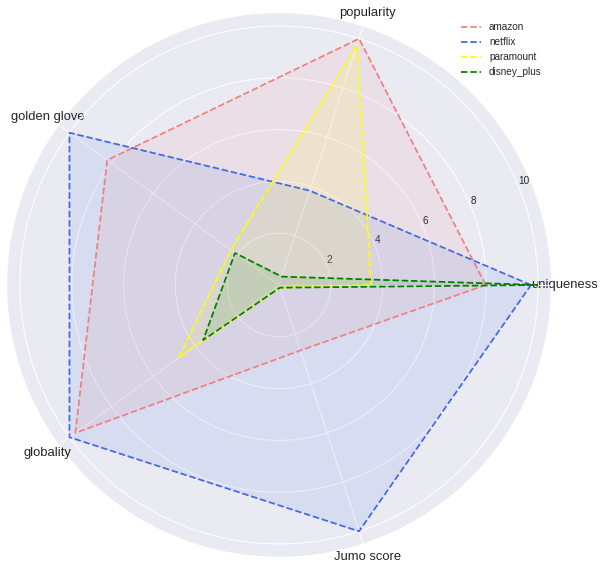

In [ ]:
categories = ['uniqueness', 'popularity', 'golden glove', 'globality', 'Jumo score']
categories = [*categories]


# 1번
amazon = [total_score[i]['Amazon'] for i in categories]
amazon = [*amazon, amazon[0]]

# 2번
netflix = [total_score[i]['Netflix'] for i in categories]
netflix = [*netflix, netflix[0]]

# 3번
paramount = [total_score[i]['Paramount'] for i in categories]
paramount = [*paramount, paramount[0]]

# 4번
disney_plus = [total_score[i]['Disney plus'] for i in categories]
disney_plus = [*disney_plus, disney_plus[0]]

label_loc = np.linspace(start=0, stop=2*np.pi, num=len(amazon))

plt.figure(figsize=(10,10))
ax = plt.subplot(polar=True)
plt.xticks(label_loc, labels=categories, fontsize=13)
ax.plot(label_loc, amazon, label='amazon', linestyle='dashed', color= 'lightcoral')
ax.fill(label_loc, amazon, color='lightcoral', alpha=0.1)
ax.plot(label_loc, netflix, label='netflix', linestyle='dashed', color= 'royalblue')
ax.fill(label_loc, netflix, color='royalblue', alpha=0.1)
ax.plot(label_loc, paramount, label='paramount', linestyle='dashed', color= 'yellow')
ax.fill(label_loc, paramount, color='yellow', alpha=0.1)
ax.plot(label_loc, disney_plus, label='disney_plus', linestyle='dashed', color= 'g')
ax.fill(label_loc, disney_plus, color='g', alpha=0.1)

ax.legend()
plt.show()



In [ ]:
list(total_score.keys())

['uniqueness', 'popularity', 'globality', 'golden glove', 'Jumo score']

In [ ]:
total_score_1 = total_score.copy()
del(total_score_1['Jumo score'])

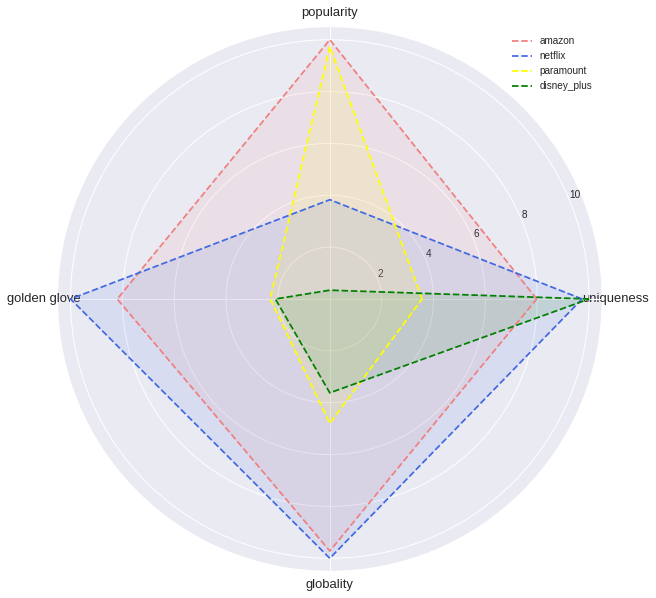

In [ ]:
categories = ['uniqueness', 'popularity', 'golden glove', 'globality']
categories = [*categories]


# 1번
amazon = [total_score_1[i]['Amazon'] for i in categories]
amazon = [*amazon, amazon[0]]

# 2번
netflix = [total_score_1[i]['Netflix'] for i in categories]
netflix = [*netflix, netflix[0]]

# 3번
paramount = [total_score_1[i]['Paramount'] for i in categories]
paramount = [*paramount, paramount[0]]

# 4번
disney_plus = [total_score_1[i]['Disney plus'] for i in categories]
disney_plus = [*disney_plus, disney_plus[0]]

label_loc = np.linspace(start=0, stop=2*np.pi, num=len(amazon))

plt.figure(figsize=(10,10))
ax = plt.subplot(polar=True)
plt.xticks(label_loc, labels=categories, fontsize=13)
ax.plot(label_loc, amazon, label='amazon', linestyle='dashed', color= 'lightcoral')
ax.fill(label_loc, amazon, color='lightcoral', alpha=0.1)
ax.plot(label_loc, netflix, label='netflix', linestyle='dashed', color= 'royalblue')
ax.fill(label_loc, netflix, color='royalblue', alpha=0.1)
ax.plot(label_loc, paramount, label='paramount', linestyle='dashed', color= 'yellow')
ax.fill(label_loc, paramount, color='yellow', alpha=0.1)
ax.plot(label_loc, disney_plus, label='disney_plus', linestyle='dashed', color= 'g')
ax.fill(label_loc, disney_plus, color='g', alpha=0.1)

ax.legend()
plt.show()



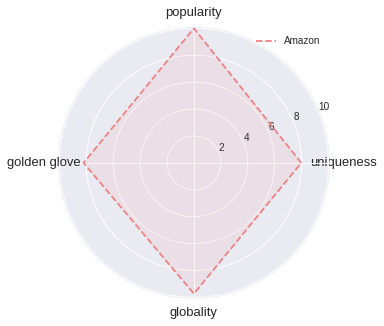

In [ ]:
categories = ['uniqueness', 'popularity', 'golden glove', 'globality']
categories = [*categories]


# 1번
amazon = [total_score_1[i]['Amazon'] for i in categories]
amazon = [*amazon, amazon[0]]

plt.figure(figsize=(5,5))
ax = plt.subplot(polar=True)
plt.xticks(label_loc, labels=categories, fontsize=13)
ax.plot(label_loc, amazon,label='Amazon', linestyle='dashed', color= 'lightcoral')
ax.fill(label_loc, amazon, color='lightcoral', alpha=0.1)


ax.legend()
plt.show()



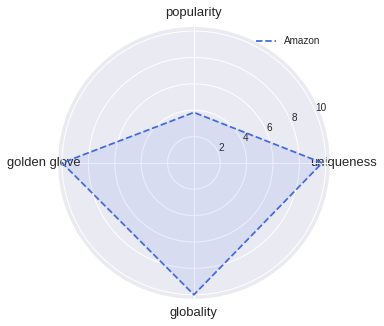

In [ ]:
categories = ['uniqueness', 'popularity', 'golden glove', 'globality']
categories = [*categories]


netflix = [total_score_1[i]['Netflix'] for i in categories]
netflix = [*netflix, netflix[0]]

# 3번
paramount = [total_score_1[i]['Paramount'] for i in categories]
paramount = [*paramount, paramount[0]]

# 4번
disney_plus = [total_score_1[i]['Disney plus'] for i in categories]
disney_plus = [*disney_plus, disney_plus[0]]

label_loc = np.linspace(start=0, stop=2*np.pi, num=len(amazon))

plt.figure(figsize=(5,5))
ax = plt.subplot(polar=True)
plt.xticks(label_loc, labels=categories, fontsize=13)
ax.plot(label_loc, netflix,label='Netflix', linestyle='dashed', color= 'royalblue')
ax.fill(label_loc, netflix, color='royalblue', alpha=0.1)


ax.legend()
plt.show()



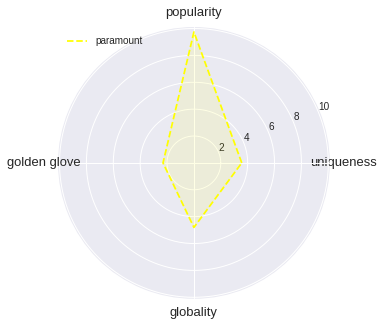

In [ ]:
categories = ['uniqueness', 'popularity', 'golden glove', 'globality']
categories = [*categories]

# 3번
paramount = [total_score_1[i]['Paramount'] for i in categories]
paramount = [*paramount, paramount[0]]


label_loc = np.linspace(start=0, stop=2*np.pi, num=len(amazon))

plt.figure(figsize=(5,5))
ax = plt.subplot(polar=True)
plt.xticks(label_loc, labels=categories, fontsize=13)
ax.plot(label_loc, paramount,label='paramount', linestyle='dashed', color= 'yellow')
ax.fill(label_loc, paramount, color='yellow', alpha=0.1)


ax.legend()
plt.show()



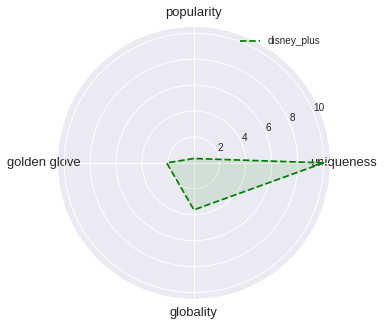

In [ ]:
categories = ['uniqueness', 'popularity', 'golden glove', 'globality']
categories = [*categories]


# 4번
disney_plus = [total_score_1[i]['Disney plus'] for i in categories]
disney_plus = [*disney_plus, disney_plus[0]]

label_loc = np.linspace(start=0, stop=2*np.pi, num=len(amazon))

plt.figure(figsize=(5,5))
ax = plt.subplot(polar=True)
plt.xticks(label_loc, labels=categories, fontsize=13)
ax.plot(label_loc, disney_plus, label='disney_plus', linestyle='dashed', color= 'g')
ax.fill(label_loc, disney_plus, color='g', alpha=0.1)

ax.legend()
plt.show()

